# Kaggle Two Sigma Financial Modeling Challenge - EDA

Exploratory Data Analysis of the Kaggle Two Sigma Financial Modeling data set
- https://www.kaggle.com/c/two-sigma-financial-modeling/

In [1]:
import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline

In [2]:
# settings 
plt.style.use('ggplot')
plt.rcParams['figure.figsize'] = (12.0, 6.0)
pd.set_option('display.max_rows', 110)
# pd.set_option('display.max_columns', 50)

In [3]:
import warnings
warnings.filterwarnings('ignore')

In [4]:
# settings 
#%logstop
#%logstart  -o '2s_EDA.log' rotate

In [5]:
import datetime
start = datetime.datetime.now()
print(start)

2017-03-14 21:03:11.977414


In [6]:
#load the data. 
train = pd.HDFStore("../input/train.h5", "r").get("train")
train.shape

(1710756, 111)

In [7]:
train.dtypes.value_counts()

float32    109
int16        2
dtype: int64

In [8]:
# for c in list(train.columns):
#     print(c)

Let's list all the features

In [9]:
derived_cols = train.filter(like='derived', axis=1).columns
derived_cols

Index(['derived_0', 'derived_1', 'derived_2', 'derived_3', 'derived_4'], dtype='object')

In [10]:
fundamental_cols = train.filter(like='fundamental', axis=1).columns
fundamental_cols

Index(['fundamental_0', 'fundamental_1', 'fundamental_2', 'fundamental_3',
       'fundamental_5', 'fundamental_6', 'fundamental_7', 'fundamental_8',
       'fundamental_9', 'fundamental_10', 'fundamental_11', 'fundamental_12',
       'fundamental_13', 'fundamental_14', 'fundamental_15', 'fundamental_16',
       'fundamental_17', 'fundamental_18', 'fundamental_19', 'fundamental_20',
       'fundamental_21', 'fundamental_22', 'fundamental_23', 'fundamental_24',
       'fundamental_25', 'fundamental_26', 'fundamental_27', 'fundamental_28',
       'fundamental_29', 'fundamental_30', 'fundamental_31', 'fundamental_32',
       'fundamental_33', 'fundamental_34', 'fundamental_35', 'fundamental_36',
       'fundamental_37', 'fundamental_38', 'fundamental_39', 'fundamental_40',
       'fundamental_41', 'fundamental_42', 'fundamental_43', 'fundamental_44',
       'fundamental_45', 'fundamental_46', 'fundamental_47', 'fundamental_48',
       'fundamental_49', 'fundamental_50', 'fundamental_51', 

In [11]:
technical_cols = train.filter(like='technical', axis=1).columns
technical_cols

Index(['technical_0', 'technical_1', 'technical_2', 'technical_3',
       'technical_5', 'technical_6', 'technical_7', 'technical_9',
       'technical_10', 'technical_11', 'technical_12', 'technical_13',
       'technical_14', 'technical_16', 'technical_17', 'technical_18',
       'technical_19', 'technical_20', 'technical_21', 'technical_22',
       'technical_24', 'technical_25', 'technical_27', 'technical_28',
       'technical_29', 'technical_30', 'technical_31', 'technical_32',
       'technical_33', 'technical_34', 'technical_35', 'technical_36',
       'technical_37', 'technical_38', 'technical_39', 'technical_40',
       'technical_41', 'technical_42', 'technical_43', 'technical_44'],
      dtype='object')

How many unique id's?

In [12]:
ids = train.id.unique()
len(ids)

1424

Over how many days?

In [13]:
times = train.timestamp.unique()
len(times)

1813

In [14]:
# Shape the train set into a panel
df_train = train.set_index(['id','timestamp'])
p = df_train.to_panel().transpose(1,2,0)
p

<class 'pandas.core.panel.Panel'>
Dimensions: 1424 (items) x 1813 (major_axis) x 109 (minor_axis)
Items axis: 0 to 2158
Major_axis axis: 0 to 1812
Minor_axis axis: derived_0 to y

## Summary statistics

In [15]:
def summary(df):
    '''
    '''
    df_summary = df.describe(include='all').T
    df_summary.index.name = 'feature'
    # pd.set_eng_float_format(use_eng_prefix=True)
    df_summary['missing'] = df.isnull().sum()
    df_summary['idx'] = list(range(1,len(df_summary.index)+1))
    # df_summary['var_type'] = df.dtypes
    # df_summary = df_summary[['idx','var_type','missing','count','mean','std','min','25%','50%','75%','max']]
    df_summary = df_summary[['idx','missing','count','mean','std','min','25%','50%','75%','max']]
    df_summary.fillna('', inplace=True)
    return df_summary

In [16]:
summary(df_train)

,idx,missing,count,mean,std,min,25%,50%,75%,max
feature,,,,,,,,,,
derived_0,1,72959,1637797.0,-4.536046e+00,2.497382e+02,-2.017497e+04,-1.449710e-01,-8.368272e-04,1.199108e-01,3.252527e+03
derived_1,2,81029,1629727.0,7.729436e+11,7.620606e+13,-7.375435e-02,-2.956479e-02,5.523058e-03,1.078554e-01,1.068448e+16
derived_2,3,398651,1312105.0,-3.320328e-01,6.519810e+01,-9.848880e+03,-5.967524e-02,2.109505e-02,1.952209e-01,3.823001e+03
derived_3,4,149471,1561285.0,-5.046012e-01,1.020749e+02,-3.434176e+04,-1.655826e-01,2.475614e-03,3.037236e-01,1.239737e+03
derived_4,5,406458,1304298.0,1.801661e+01,9.258360e+02,-8.551914e+03,-1.057050e-01,1.175234e-02,1.556464e-01,6.785965e+04
fundamental_0,6,23947,1686809.0,-2.040938e-02,2.494859e-01,-2.344957e+00,-1.996543e-01,-4.064488e-02,1.303819e-01,1.378195e+00
fundamental_1,7,679070,1031686.0,-5.703754e+08,7.502322e+10,-1.043737e+13,-1.960470e-01,-7.395084e-03,1.832071e-01,5.203165e+02
fundamental_2,8,368840,1341916.0,-1.622954e-01,3.668149e+00,-1.077101e+03,-2.280967e-01,-3.029069e-02,1.764751e-01,7.677125e+01
fundamental_3,9,454380,1256376.0,2.780239e-02,3.076004e-01,-3.734025e-01,-1.816914e-01,-4.018341e-02,1.560143e-01,6.552332e+00


## Target Y

In [17]:
# pick an index into the panel
i = 0
y = p[i].y.dropna()

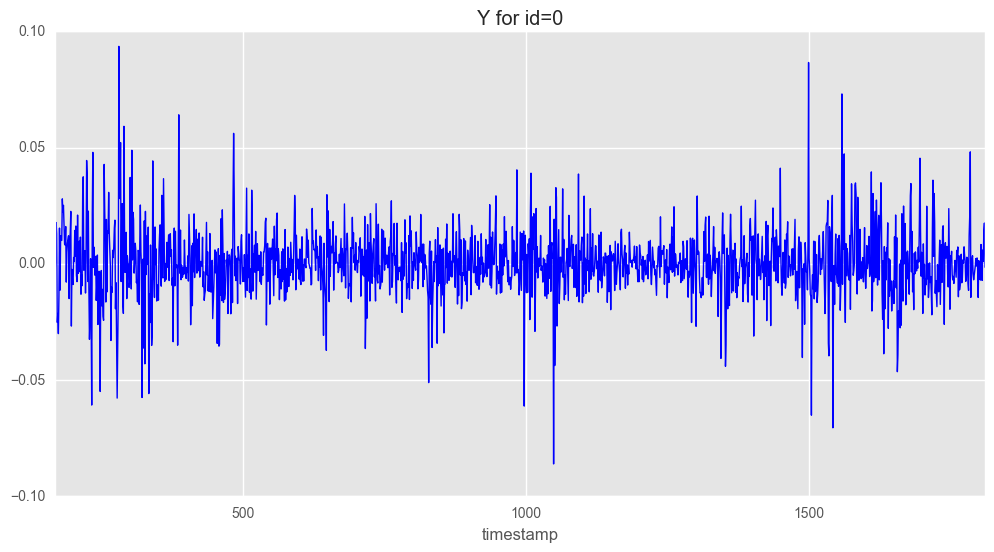

In [18]:
ax = y.plot(color='blue', lw=1, title='Y for id='+str(i))

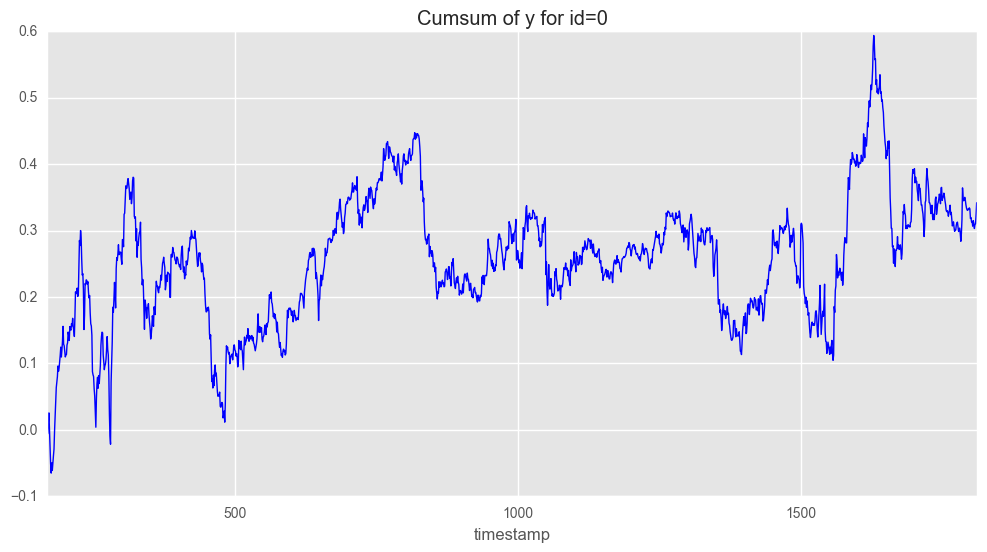

In [19]:
ax = y.cumsum().plot(color='b', lw=1, title='Cumsum of y for id='+str(i))

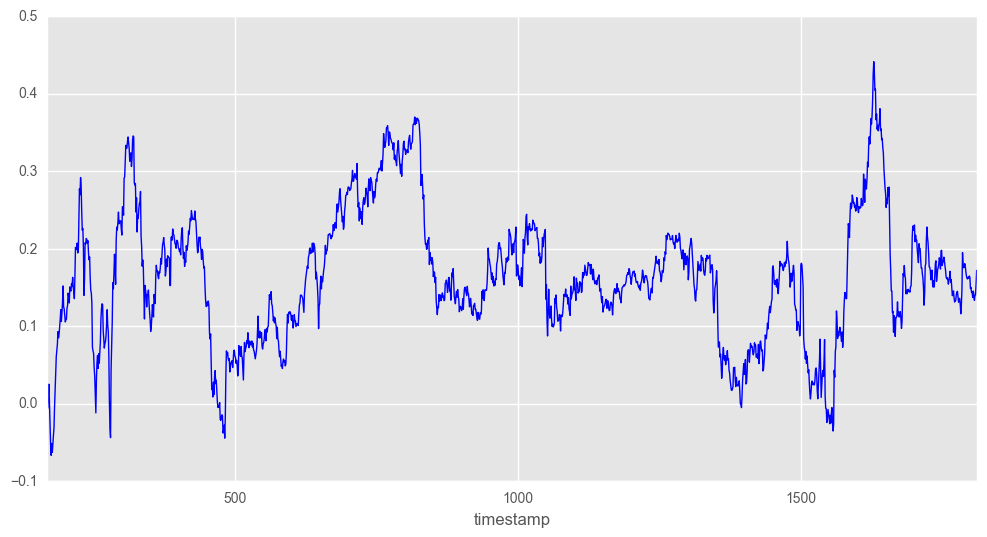

In [20]:
# is y a percentage change per time return? or log returns?
cum_y = np.log(1+y).cumsum()
ax = cum_y.dropna().plot(color='blue', lw=1)

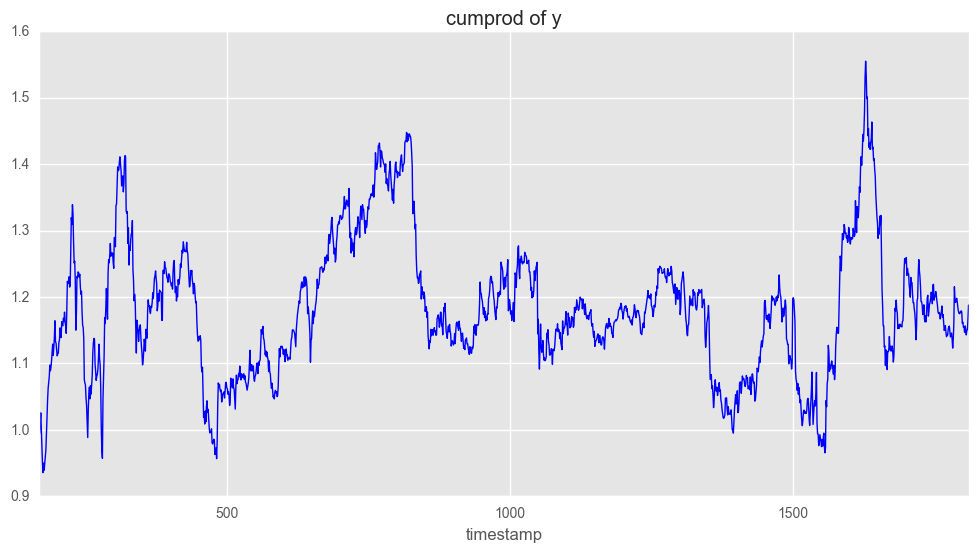

In [21]:
# or cumprod?
ax = (y + 1).cumprod().plot(color='blue', lw=1, title='cumprod of y')

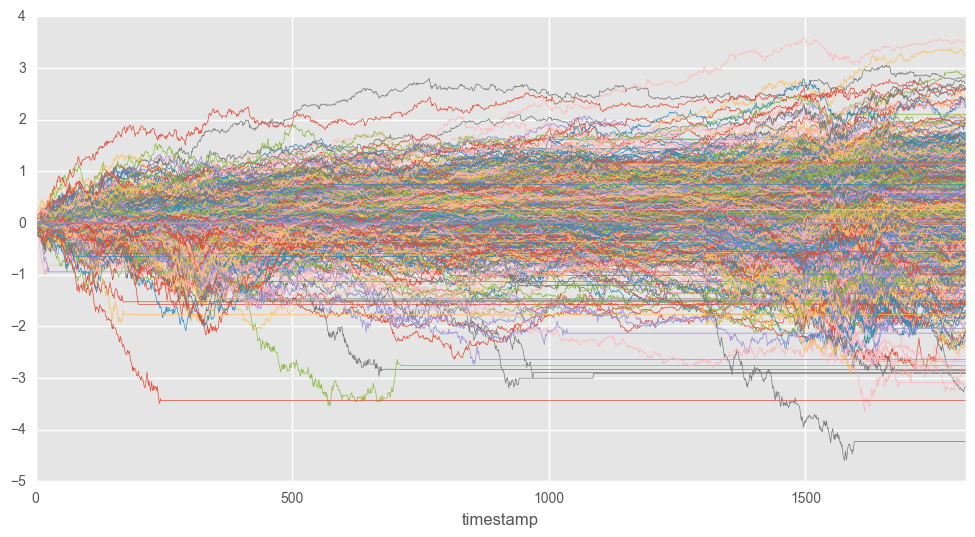

In [22]:
# plot all the y values 
ax = p.loc[:,:,'y'].fillna(0).cumsum().plot(lw=0.5, legend=False)

In [23]:
# index of the lowest cumsum y
min_id = p.loc[:,:,'y'].fillna(0).cumsum().min().idxmin()
min_id

1732

In [24]:
# confirm that the lowest y in fact stops trading
p[min_id].y.tail()

timestamp
1808   NaN
1809   NaN
1810   NaN
1811   NaN
1812   NaN
Name: y, dtype: float32

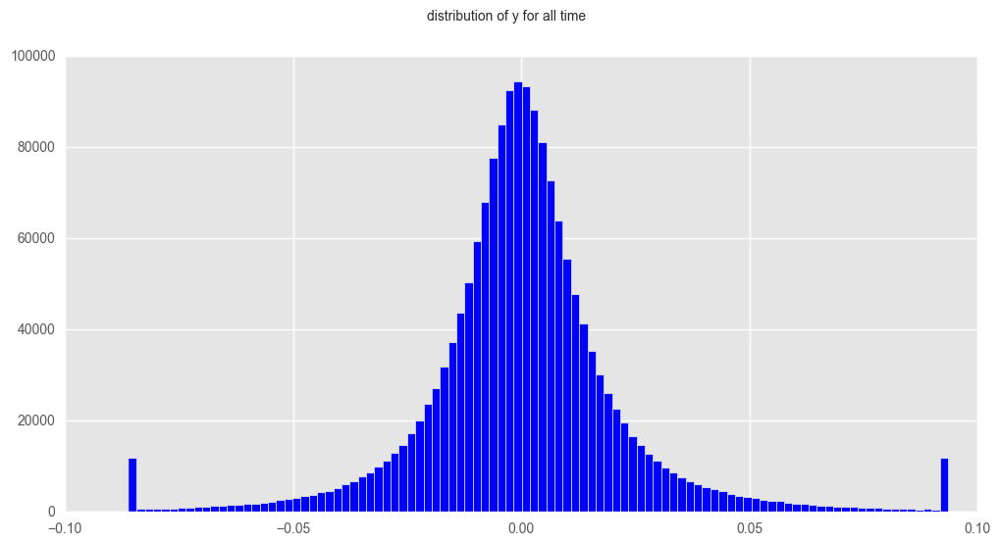

In [25]:
# distribution of y for all time
# all_y = pd.Series(p.loc[:,:,'y'].values.flatten())
all_y = df_train.y
ax=all_y.hist(bins=100, facecolor='blue')
ax=plt.suptitle('distribution of y for all time')

let's look at one extreme in detail

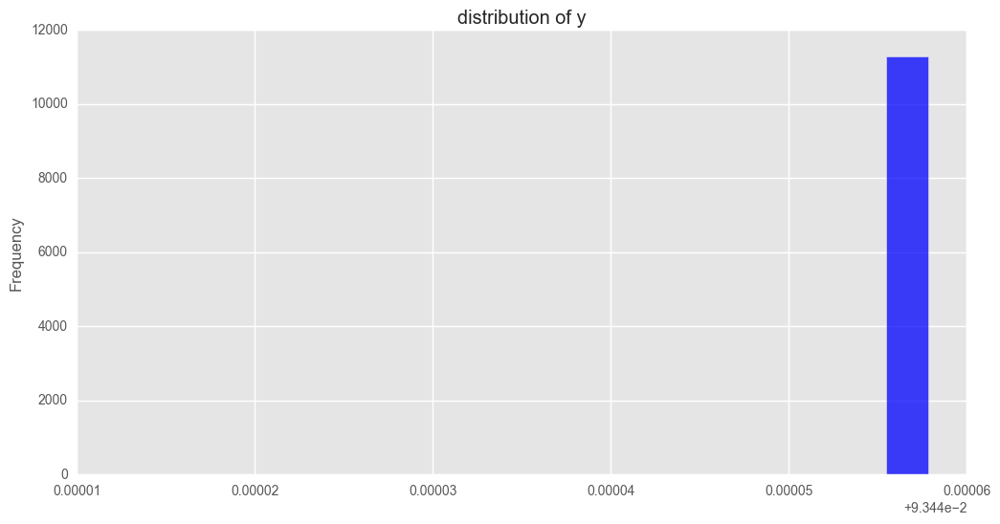

In [26]:
# n, bins, patches = plt.hist(all_y[all_y > .09345], 200, facecolor='blue', alpha=0.75)
ax = all_y[all_y > .09345].plot.hist(bins=20, facecolor='blue', alpha=0.75, 
                                     title='distribution of y')

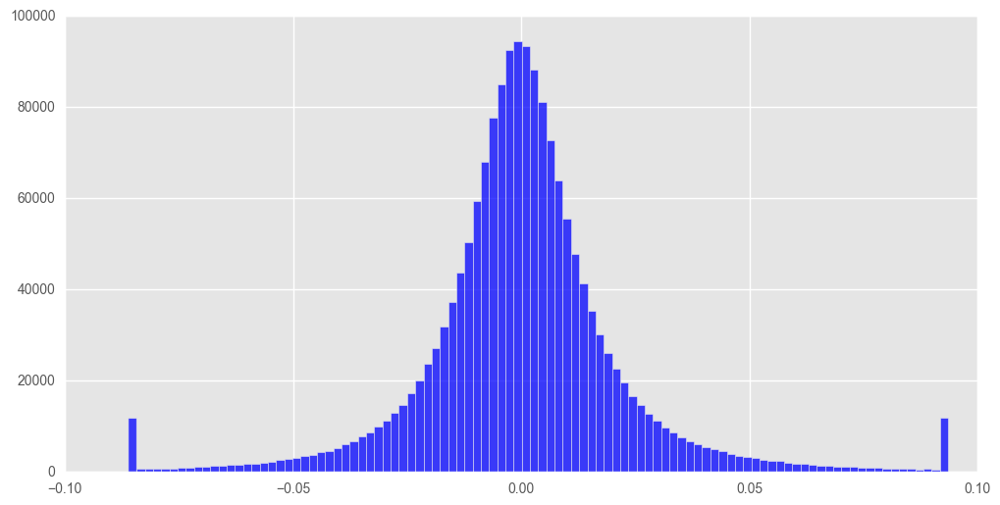

In [27]:
# plot again to get the bin spans 
all_y=all_y.dropna()
n, bins, patches = plt.hist(all_y.values, 100, facecolor='blue', alpha=0.75)

In [28]:
# Credit due: https://www.kaggle.com/dremovd/two-sigma-financial-modeling/y-clips
#
from collections import Counter

Counter(all_y).most_common(n = 4)

[(0.093497805, 11286), (-0.086094126, 11173), (0.0, 15), (-0.002967607, 3)]

Capping and truncating here


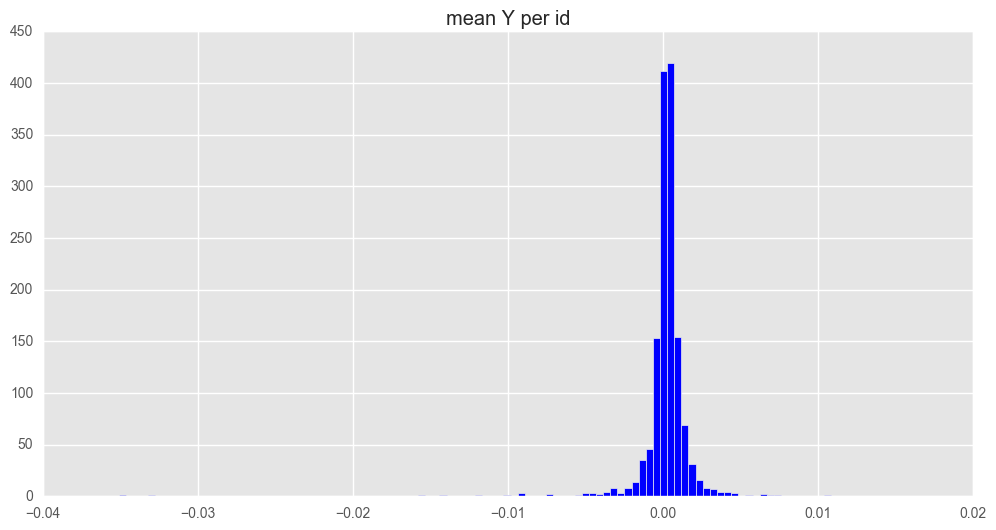

In [29]:
# mean Y per id
ax = p.loc[:,:,'y'].mean().hist(bins=100,facecolor='b')
ax = plt.title('mean Y per id')

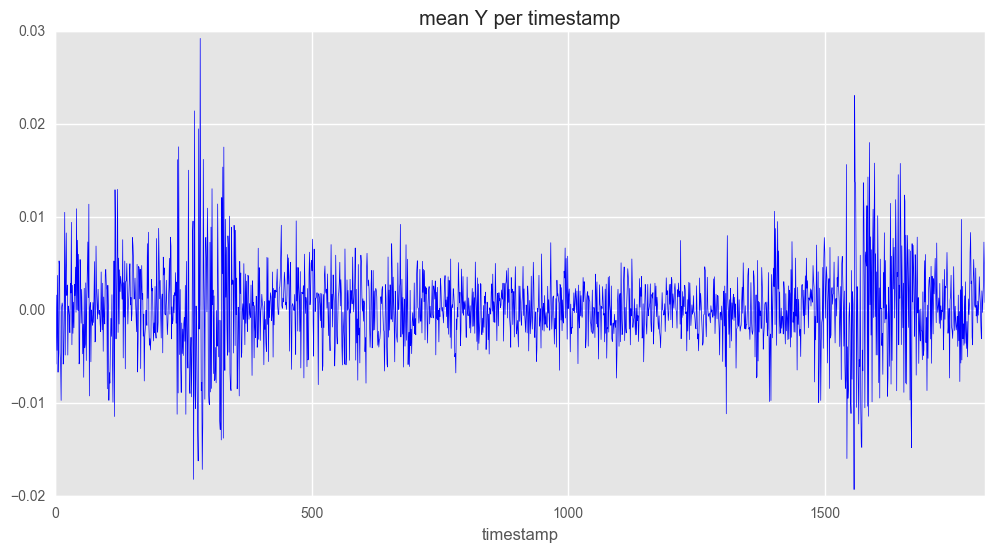

In [30]:
# mean Y per timestamp
ax = p.loc[:,:,'y'].mean(axis=1).plot(c='b',lw=0.5)
ax = plt.title('mean Y per timestamp')

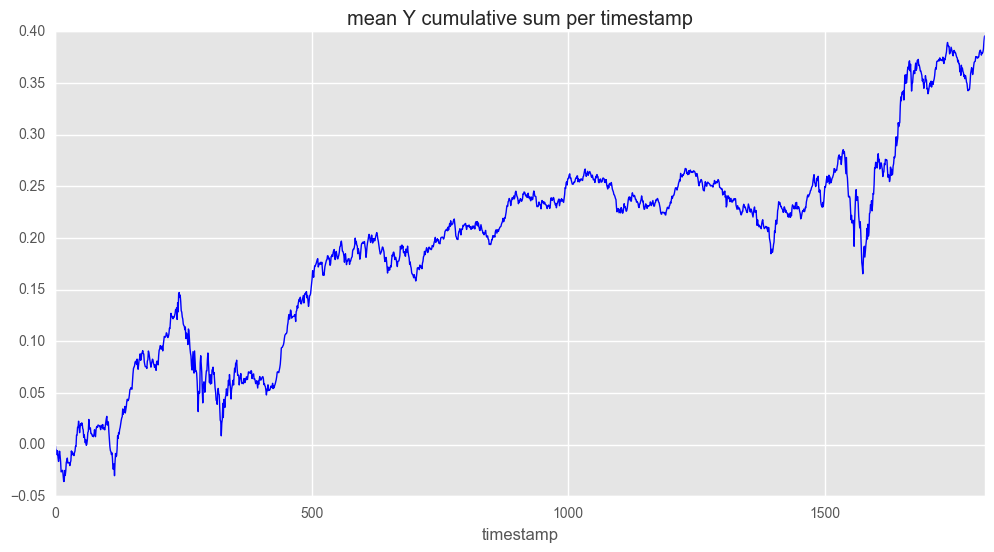

In [31]:
# mean Y per timestamp
ax = p.loc[:,:,'y'].T.mean().cumsum().plot(lw=1, c='b', title='mean Y cumulative sum per timestamp')

In [32]:
# create df of y distributions per time period
dfy = p.loc[:,:,'y'].T
ybins = pd.concat([dfy[x].groupby(pd.cut(dfy[x],bins)).count() for x in dfy.columns],axis=1)

In [33]:
# convert df into x,y,z coordinate triples
coo = ybins.unstack()
coo = pd.DataFrame(coo).reset_index()
coo.columns=['time','bins','cnt']

In [34]:
# get a number from the bin name
import re
coo.bins = coo.bins.apply(lambda x: float(re.search(r'-?\d\.\d*',x).group()))

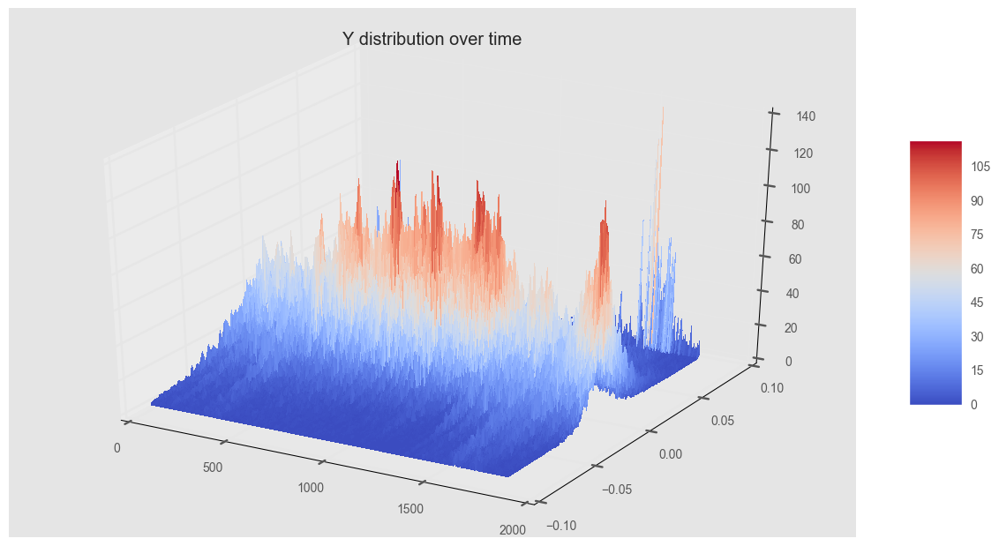

In [35]:
# plot the Y distribution over time
from mpl_toolkits.mplot3d import Axes3D

fig = plt.figure()
ax = Axes3D(fig)
surf = ax.plot_trisurf(coo.time, coo.bins, coo.cnt, cmap=plt.cm.coolwarm, linewidth=0, antialiased=False)
#ax.set_zlim(-1.01, 1.01)

#ax.zaxis.set_major_locator(LinearLocator(10))
#ax.zaxis.set_major_formatter(FormatStrFormatter('%.02f'))

fig.colorbar(surf, shrink=0.5, aspect=5)
plt.title('Y distribution over time')
plt.show()

In [36]:
## ??? reduce to two dimensions to a measure volatility ???


## Timestamp

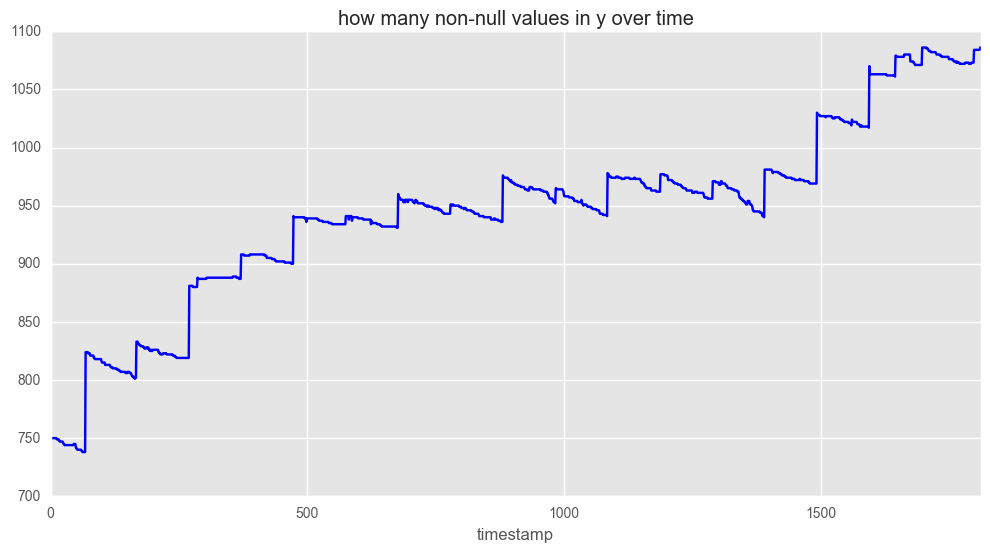

In [37]:
# how many non-null values in y over time ?
nonull_y = p.loc[:,:,'y'].notnull().astype(int).sum(axis=1)
nonull_y.plot(c='b', title='how many non-null values in y over time')

In [38]:
# let's look at the first step change in detail
nonull_y[60:70]

timestamp
60    739
61    739
62    738
63    738
64    738
65    738
66    738
67    738
68    824
69    824
dtype: int64

What is the delta between jumps in non-null y counts?

In [39]:
#
delta_nonull_y = nonull_y.loc[nonull_y.shift(-1) - nonull_y > 8]
pd.Series(delta_nonull_y.index[1:]) -  pd.Series(delta_nonull_y.index[:])# - delta_nonull_y.shift(1)

0      99.0
1     103.0
2     101.0
3     102.0
4     204.0
5     204.0
6     103.0
7     101.0
8     103.0
9     102.0
10    101.0
11    102.0
12    102.0
13     51.0
14     52.0
15    101.0
16      NaN
Name: timestamp, dtype: float64

I'll speculate it looks like the universe of tradable securities is expanded after 50 or ~100 days (quarterly?), and during the period a number of sercurities drop off (delisted, acquired, etc.)

## Features per id

In [40]:
# Let's inspect the features
# pick an id to review
i = 0

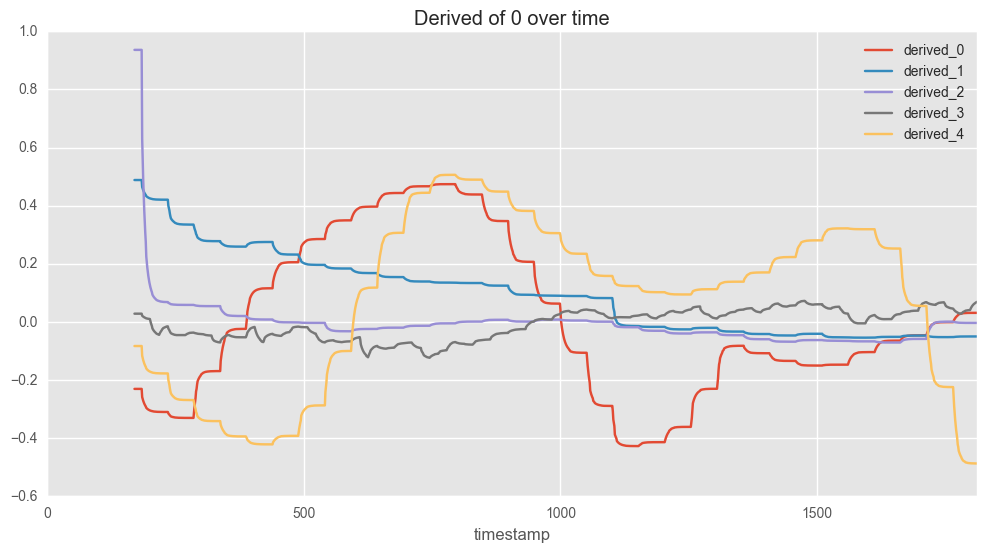

In [41]:
# what does drived look like?
ax = p[i][derived_cols].plot(title='Derived of '+str(i)+' over time')

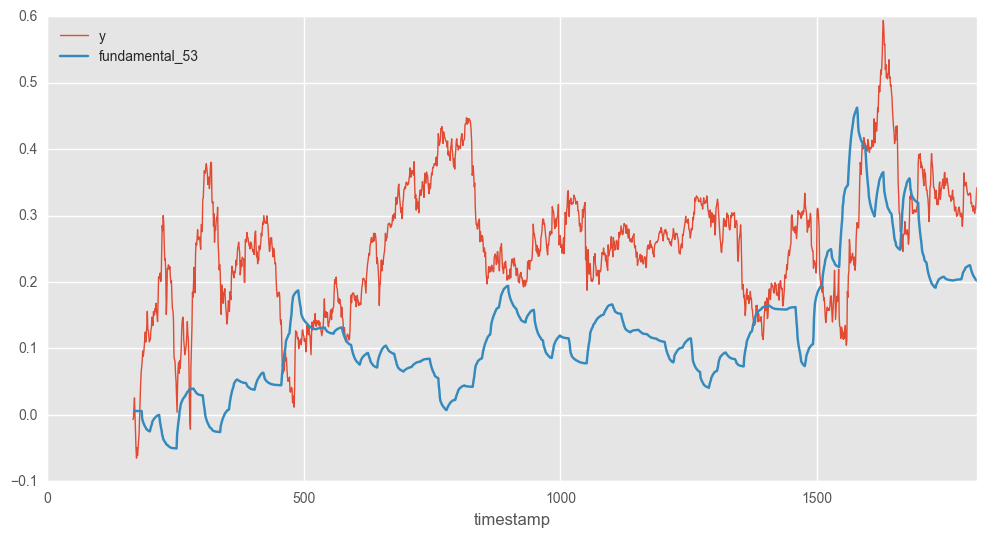

In [42]:
ax = p[i].y.cumsum().plot(legend=True,lw=1) 
ax = p[i].fundamental_53.plot(legend=True)
# ax = p[i].fundamental_3.plot(legend=True)
# ax = p[i].fundamental_6.plot(legend=True)
# ax = p[i].fundamental_9.plot(legend=True)

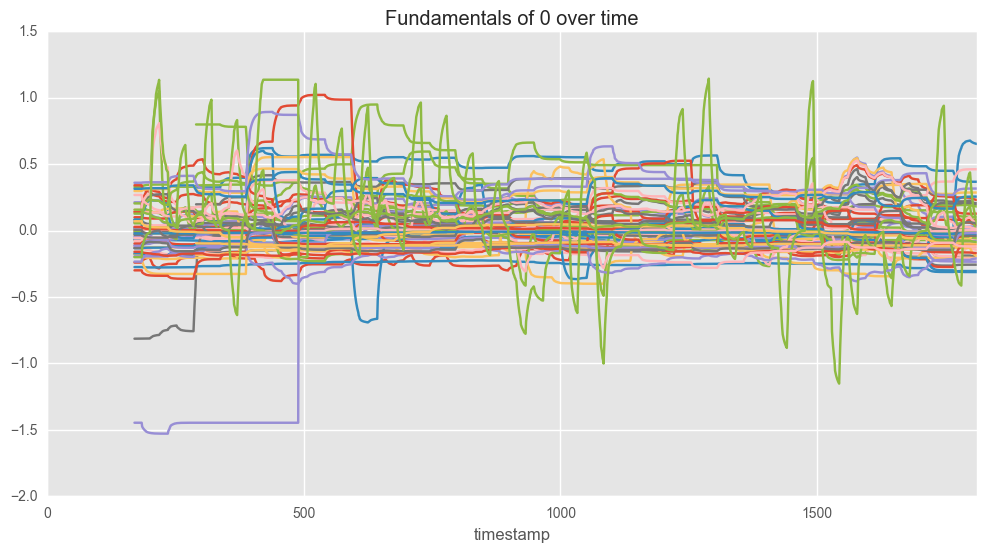

In [43]:
ax = p[i][fundamental_cols].plot(legend=False) 
ax = plt.title('Fundamentals of '+str(i)+' over time')

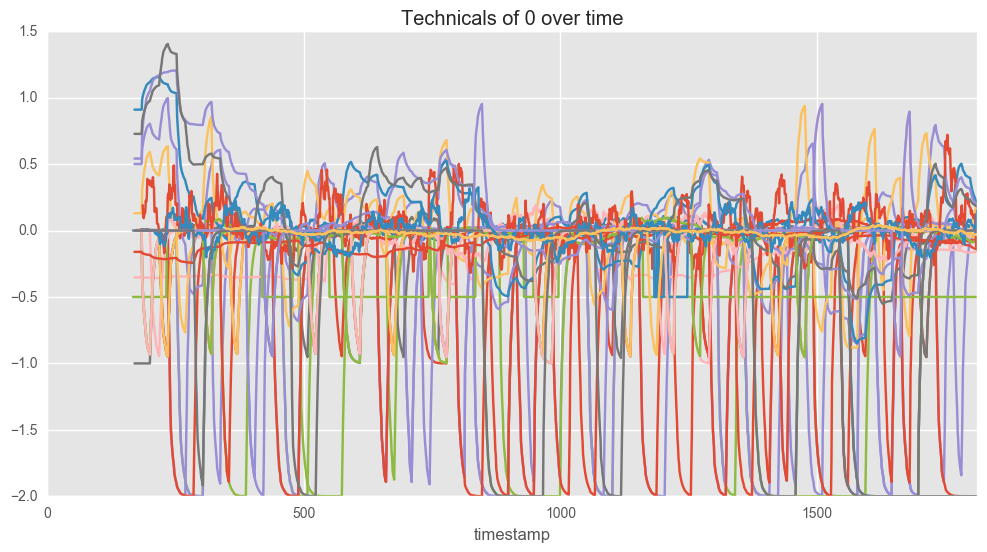

In [44]:
ax = p[i][technical_cols].plot(legend=False)
ax = plt.title('Technicals of '+str(i)+' over time')

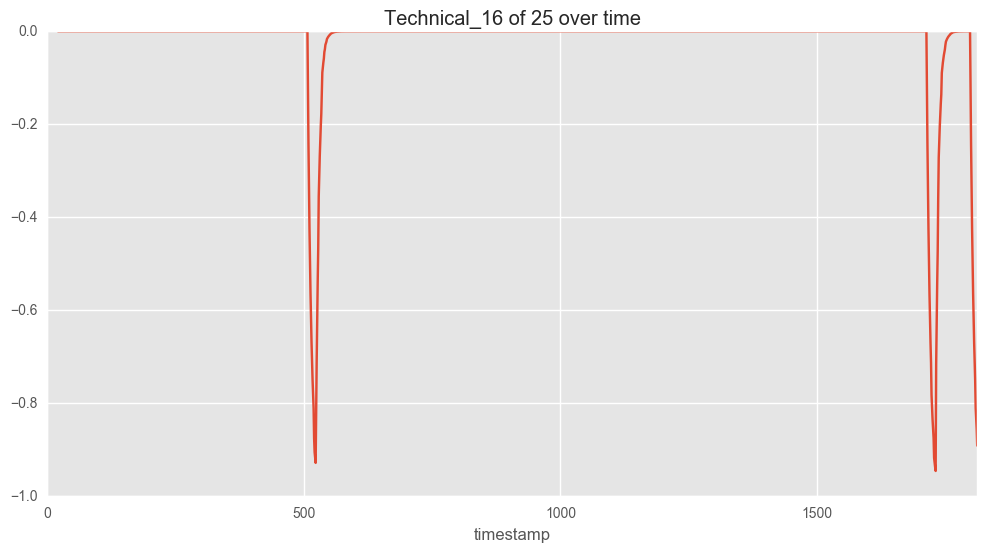

In [45]:
i = 25
ax = p[i]['technical_16'].plot(legend=False)
ax = plt.title('Technical_16 of '+str(i)+' over time')

## Let's look at derived in more detail

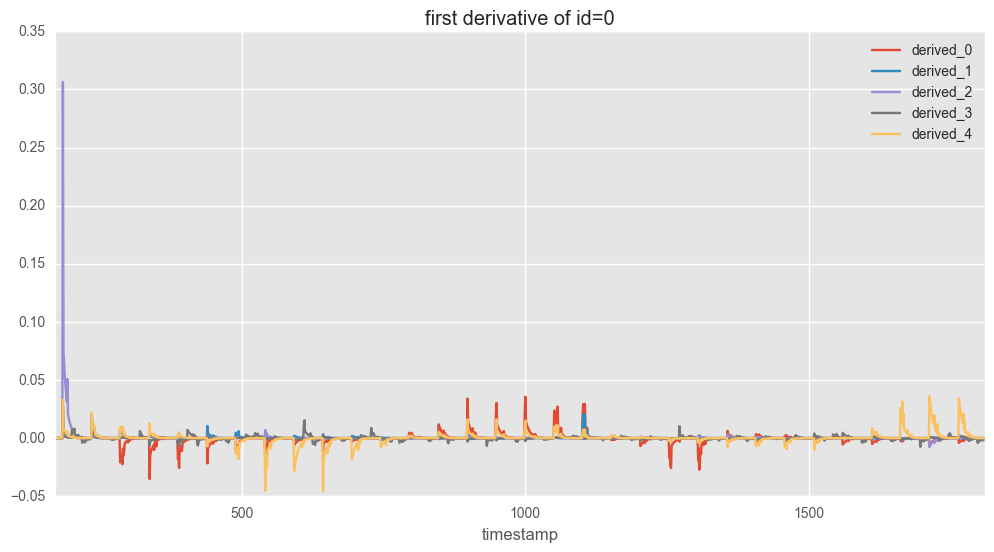

In [46]:
i = 0
af = p[i][derived_cols].dropna(how='all')
cnt = -1
ax = (af[:cnt] - af[:cnt].shift(-1)).plot(title='first derivative of id='+str(i))

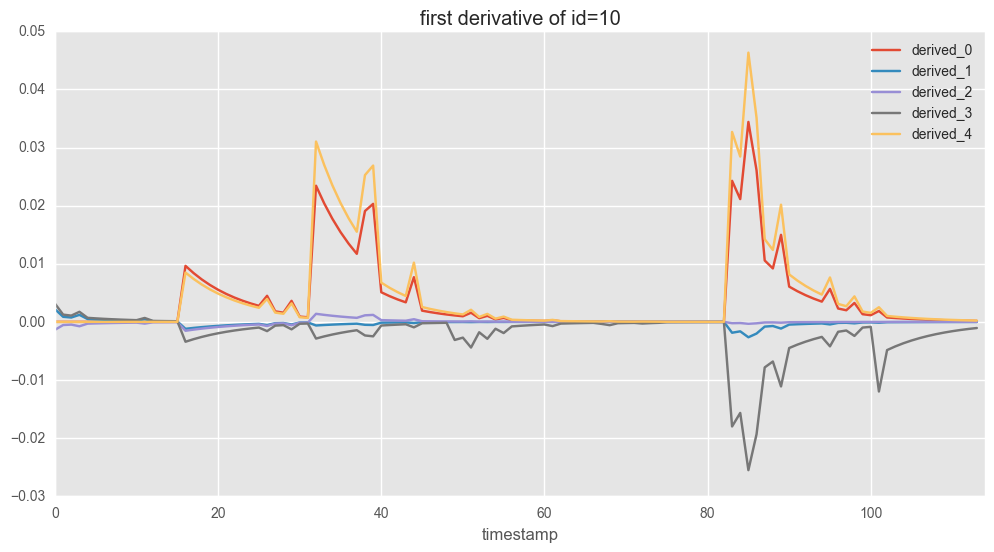

In [47]:
i = 10
af = p[i][derived_cols].dropna(how='all')
cnt = -1
ax = (af[:cnt] - af[:cnt].shift(-1)).plot(title='first derivative of id='+str(i))

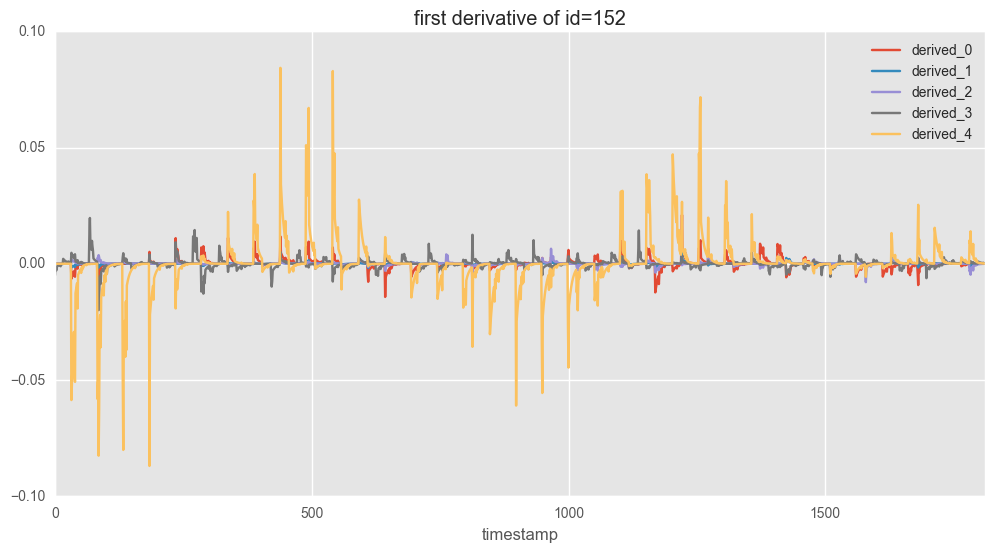

In [48]:
i = p.items[100]
af = p[i][derived_cols].dropna(how='all')
cnt = -1
ax = (af[:cnt] - af[:cnt].shift(-1)).plot(title='first derivative of id='+str(i))

## Distribution of feature for all time and all ids

In [49]:
# ## ??? plot Y in hist buckets
# def plot_dist(panel,col,threshold=0.2):
#     plt.rcParams['figure.figsize'] = (6.0, 3.0)
#     all_vals = pd.Series(panel.loc[:,:,col].values.flatten())
#     small_q = all_vals.dropna().quantile(threshold)
#     large_q = all_vals.dropna().quantile(1.0-threshold)
#     all_vals = all_vals[(all_vals > small_q) & (all_vals < large_q)] # clip outliners at threshold
#     bincnt=100
#     ax = all_vals.hist(bins=bincnt, facecolor='blue')
#     bins = np.linspace(small_q, large_q, num=bincnt, endpoint=True, retstep=False)
#     freq, bins = np.histogram(all_vals, bins)
#     pd.DataFrame([bins,freq])
#     ax = plt.title(col)
#     plt.show()

In [50]:
df_train = train.copy()
df_train = df_train.set_index(['id','timestamp'])
median_y_df = pd.DataFrame([p.loc[:,:,'y'].median(axis=1).values]*len(p.items), columns=p.major_axis, index=p.items).T
y_diff = p.loc[:,:,'y'] - median_y_df
p.loc[:,:,'y_diff'] = y_diff

In [51]:
# 
def plot_dist_delta(panel,col,threshold=0.2, bincnt=100):
    plt.rcParams['figure.figsize'] = (10.0, 3.0)
    all_vals = pd.Series(panel.loc[:,:,col].values.flatten())
    all_y = pd.Series(panel.loc[:,:,'y_diff'].values.flatten())
    small_q = all_vals.dropna().quantile(threshold)
    large_q = all_vals.dropna().quantile(1.0-threshold)
    all_vals = all_vals[(all_vals > small_q) & (all_vals < large_q)] # clip outliners at threshold
    all_y = all_y[all_vals.index]

    fig, ax1 = plt.subplots()
    n, bins, patches = ax1.hist(all_vals, bincnt, facecolor='blue', alpha=0.5)
    ax1.set_title(col)
    ax1.set_xlabel('bins')
    ax1.set_ylabel('counts', color='b')
    ax1.tick_params('y', colors='b')
    # http://stackoverflow.com/questions/27709992/average-line-for-bar-chart-in-matplotlib
    ax1.axvline(all_vals.mean(), color='g', linewidth=1)
    bins = np.linspace(small_q, large_q, num=bincnt, endpoint=True, retstep=False)
    try:
        groups = all_vals.groupby(pd.cut(all_vals,bincnt))
        mean_y = []
        for g in groups:
            mean_y.append(all_y[g[1].index].mean())
        ax2 = ax1.twinx()
        ax2.grid(b=False)
        l = ax2.plot(bins, mean_y, 'r.', markersize=8, alpha=0.5)
        ax2.set_ylabel('mean of delta to y median per bin', color='r')
        ax2.tick_params('y', colors='r')
    except:
        pass
    plt.show()

In [52]:
# 
def plot_dist_mean(panel,col,threshold=0.2, bincnt=100):
    plt.rcParams['figure.figsize'] = (10.0, 3.0)
    all_vals = pd.Series(panel.loc[:,:,col].values.flatten())
    all_y = pd.Series(panel.loc[:,:,'y'].values.flatten())
    small_q = all_vals.dropna().quantile(threshold)
    large_q = all_vals.dropna().quantile(1.0-threshold)
    all_vals = all_vals[(all_vals > small_q) & (all_vals < large_q)] # clip outliners at threshold
    all_y = all_y[all_vals.index]

    fig, ax1 = plt.subplots()
    n, bins, patches = ax1.hist(all_vals, bincnt, facecolor='blue', alpha=0.5)
    ax1.set_title(col)
    ax1.set_xlabel('bins')
    ax1.set_ylabel('counts', color='b')
    ax1.tick_params('y', colors='b')
    # http://stackoverflow.com/questions/27709992/average-line-for-bar-chart-in-matplotlib
    ax1.axvline(all_vals.mean(), color='g', linewidth=1)
    bins = np.linspace(small_q, large_q, num=bincnt, endpoint=True, retstep=False)
    try:  # this fails if all_vals is empty or the cut does not return a list of unique values 
        groups = all_vals.groupby(pd.cut(all_vals,bincnt))
        mean_y = []
        for g in groups:
            mean_y.append(all_y[g[1].index].mean())
        ax2 = ax1.twinx()
        ax2.grid(b=False)
        l = ax2.plot(bins, mean_y, 'r.', markersize=8, alpha=0.5)
        ax2.set_ylabel('mean y per bin', color='r')
        ax2.tick_params('y', colors='r')
    except:
        pass
    plt.show()

### Derived

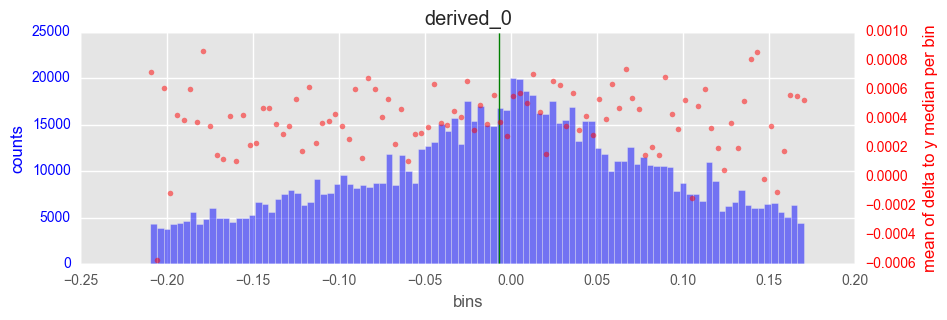

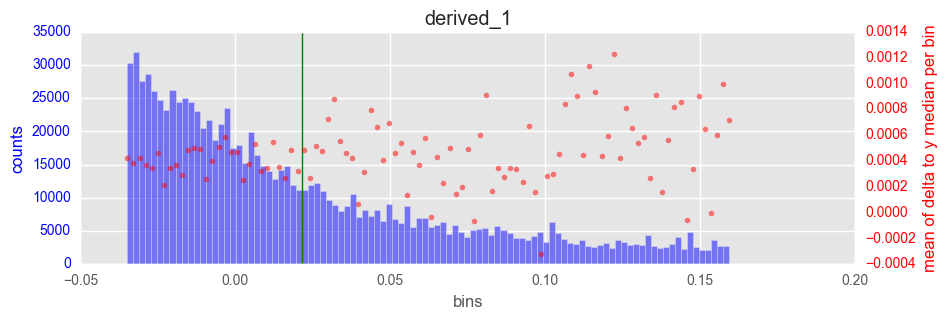

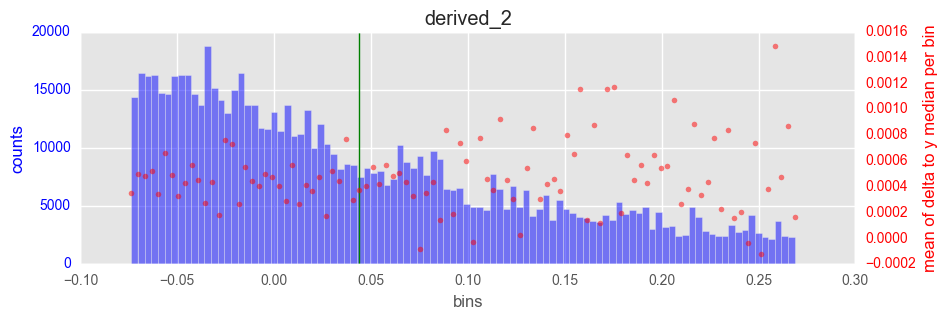

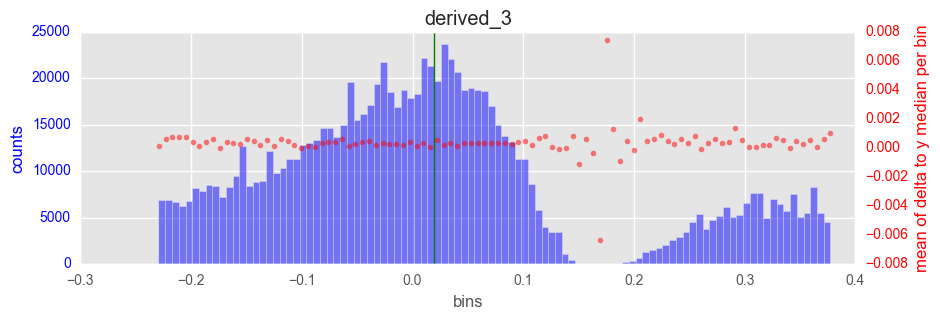

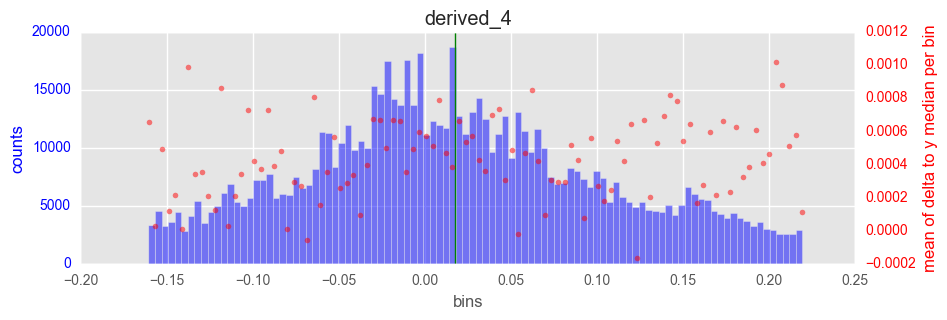

In [53]:
for c in derived_cols:
    plot_dist_delta(p,c)

## Fundamental

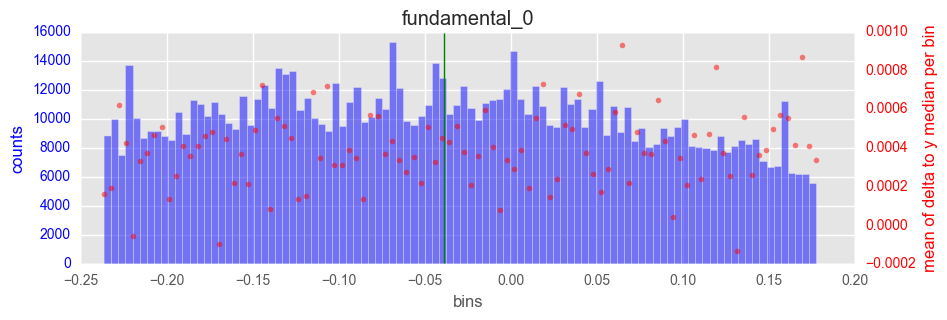

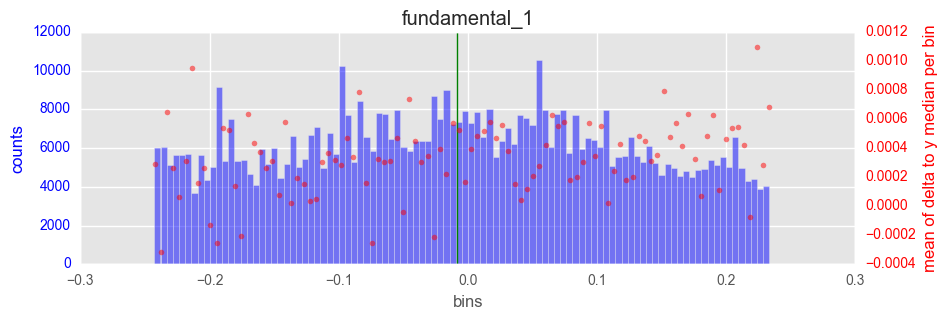

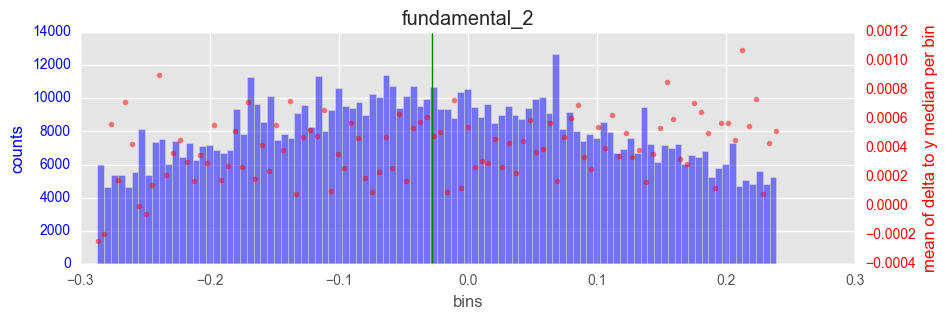

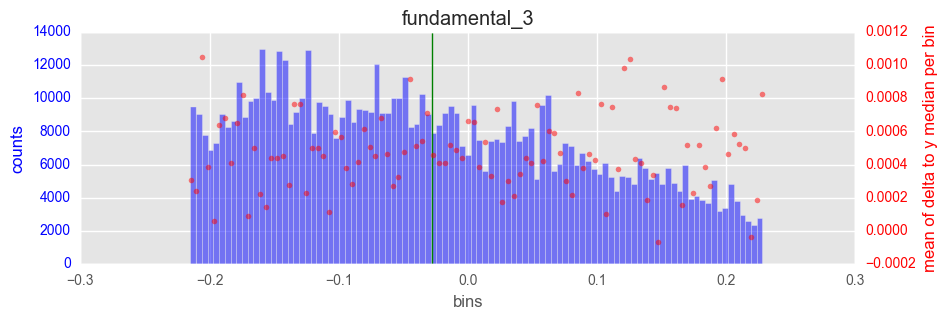

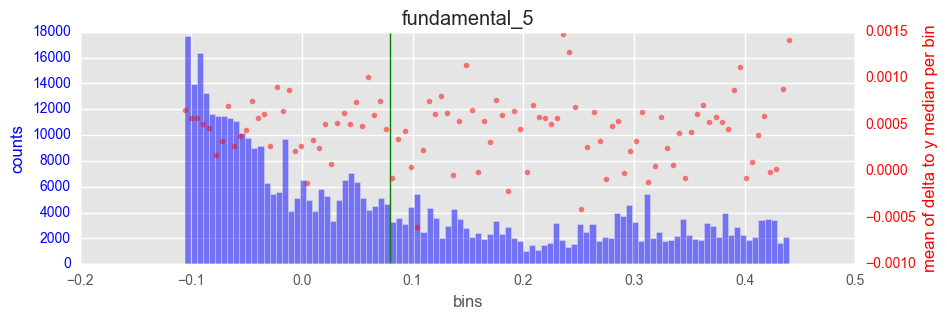

...

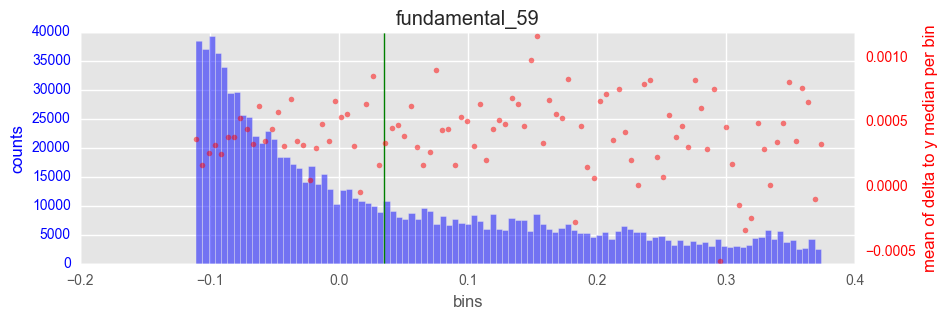

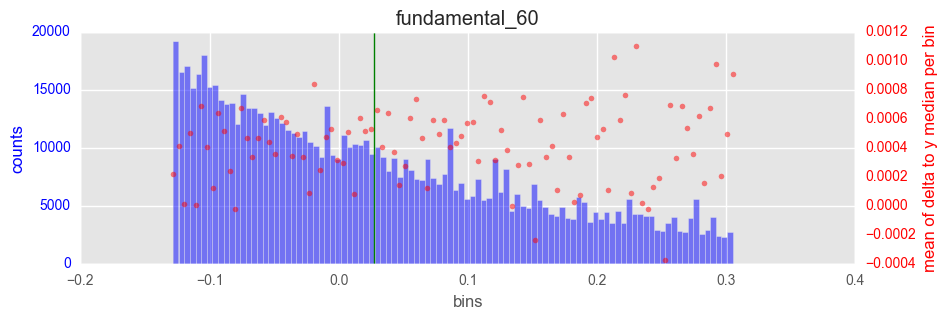

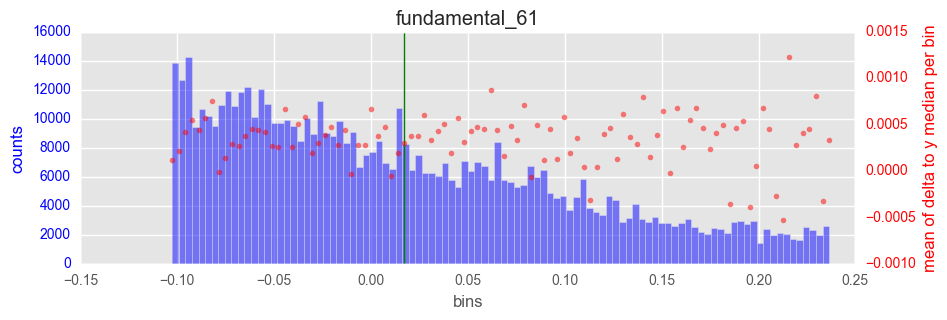

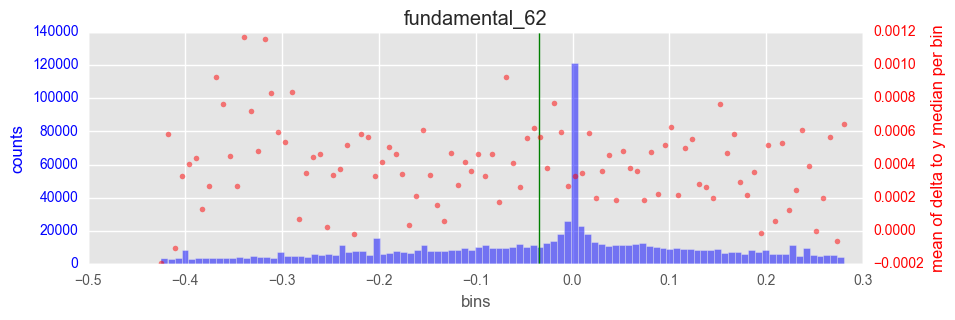

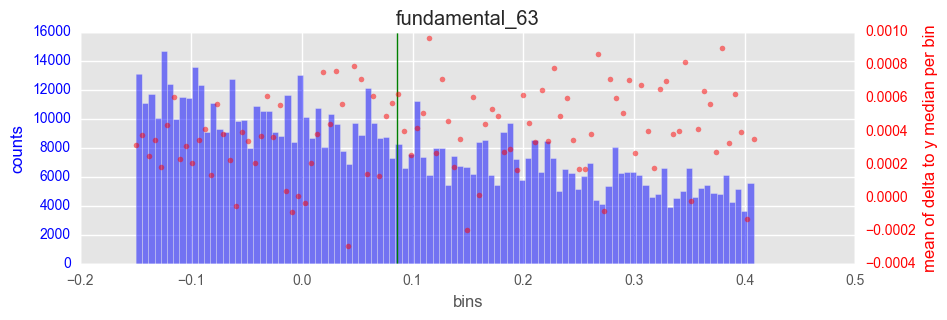

In [54]:
for c in fundamental_cols:
    plot_dist_delta(p,c)

## Technical

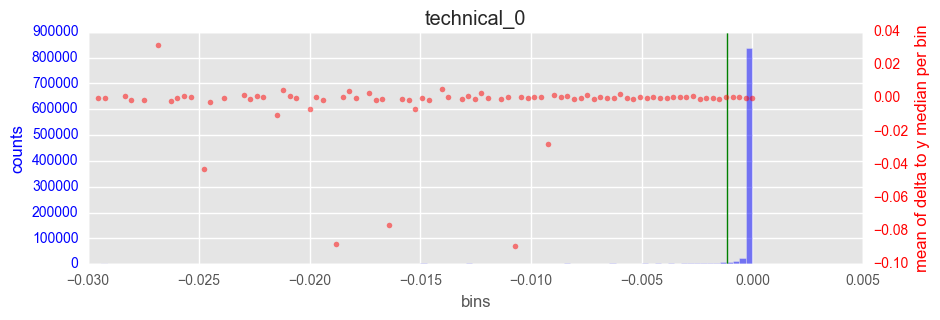

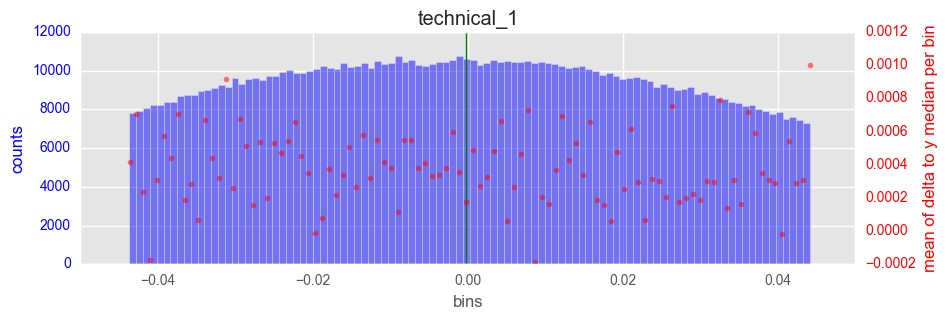

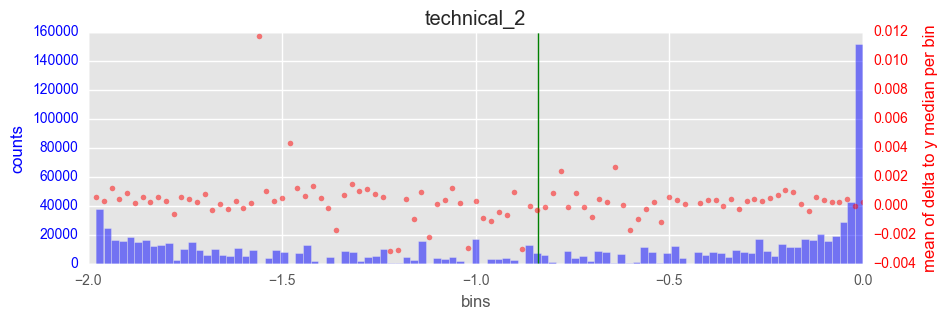

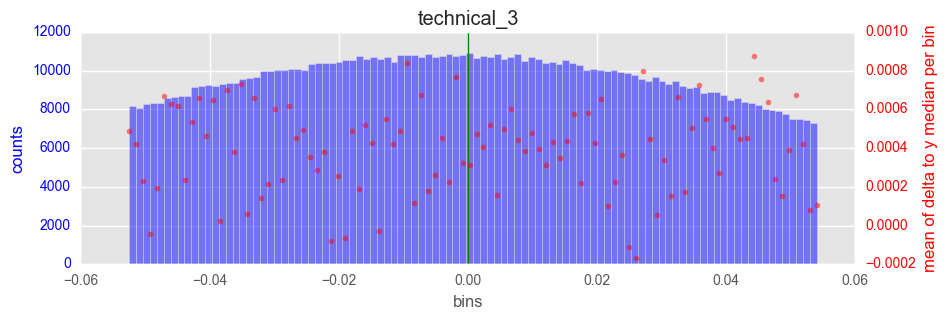

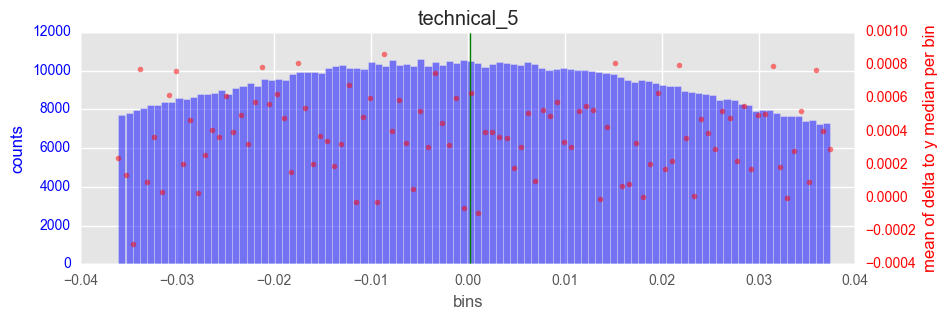

...

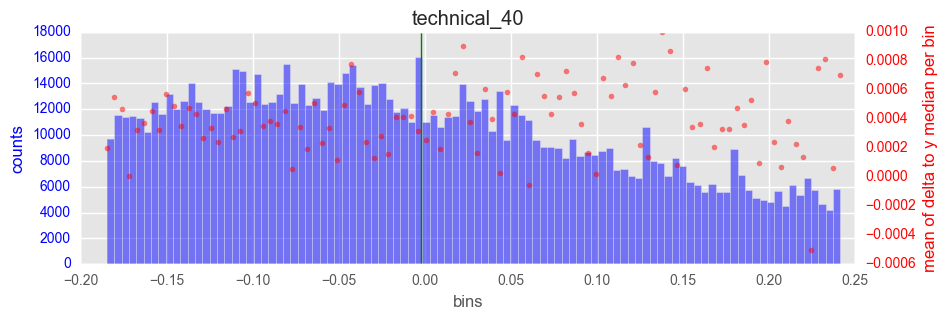

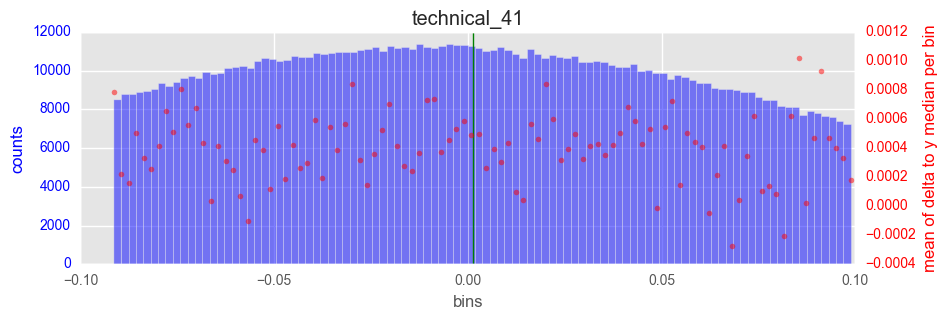

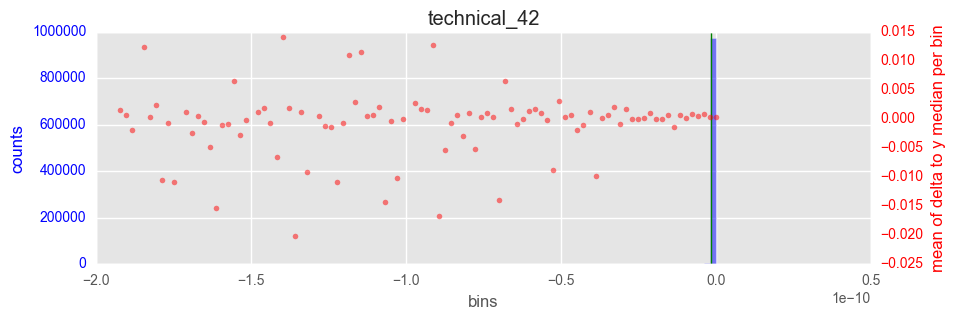

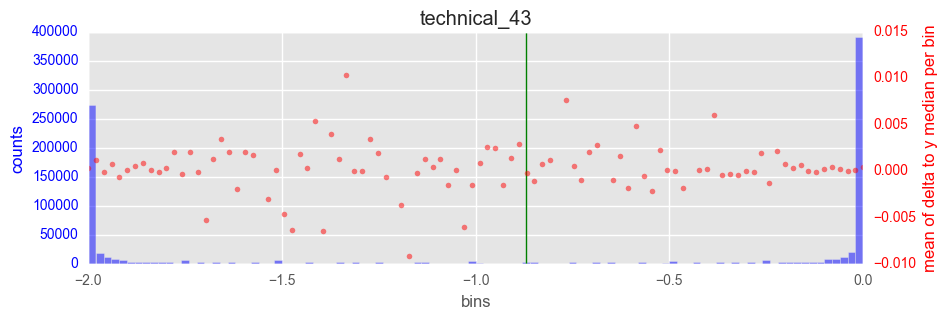

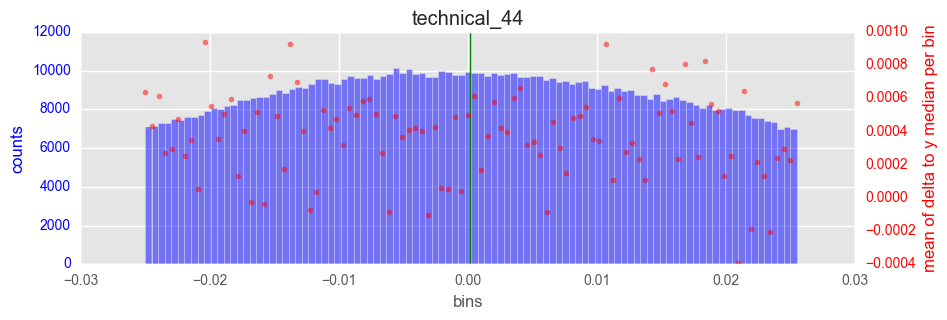

In [55]:
for c in technical_cols:
    plot_dist_delta(p,c)

In [56]:
import gc
gc.collect()

41163

## Feature v Target Joint Plot

In [59]:
def plotc(df):
    '''
    plot the continuous variable
    '''
    g = sns.jointplot(df.columns[0], df.columns[1], data=df, kind='reg',size=6, color='b', joint_kws={"scatter_kws": {"s": 2}})
    plt.show()  # flush
    return

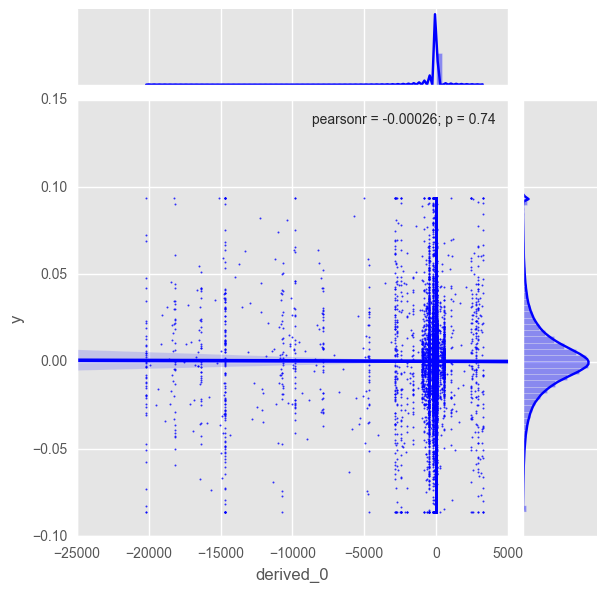

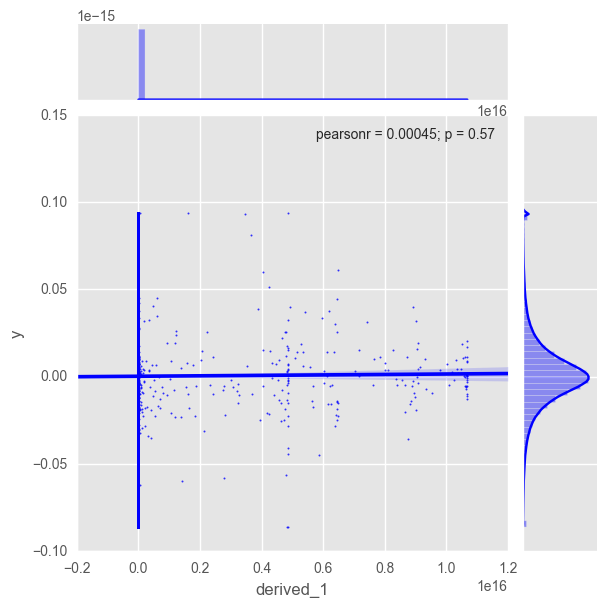

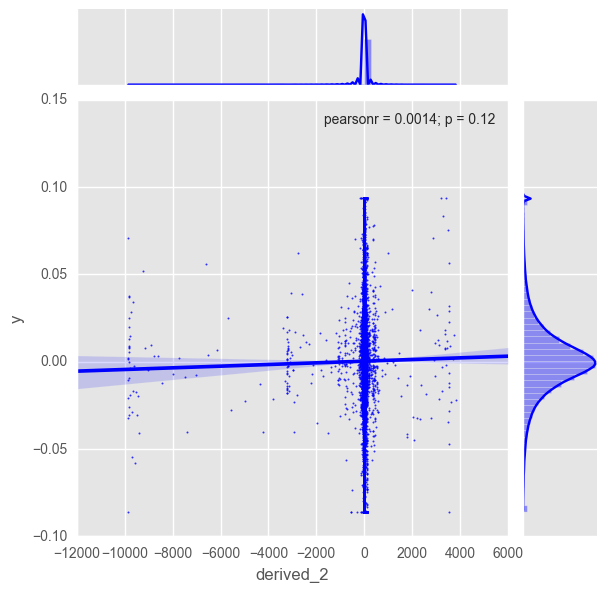

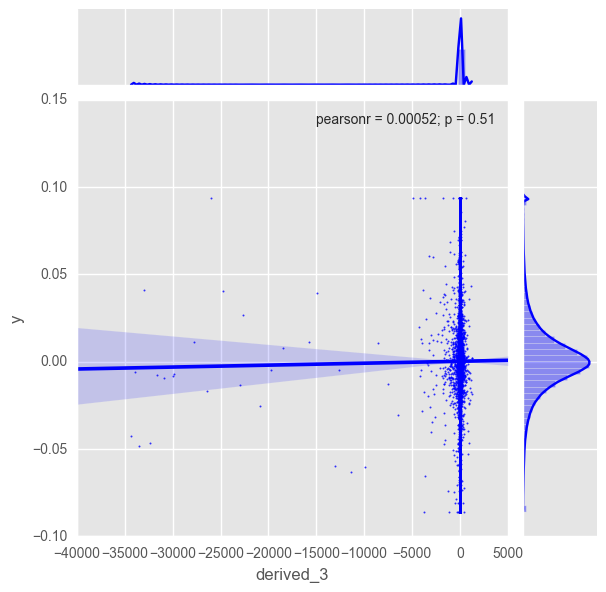

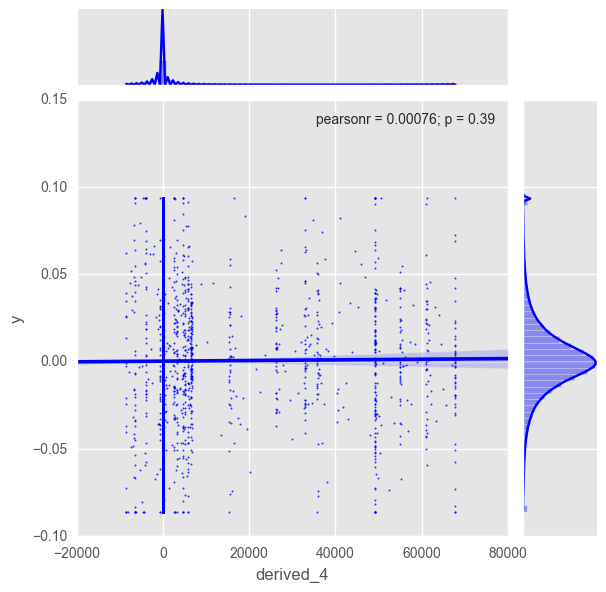

In [60]:
for c in derived_cols:
    plotc(train[[c,'y']])

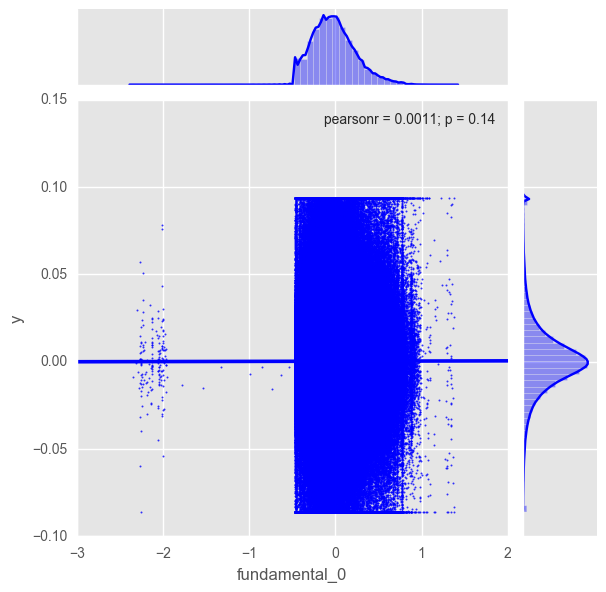

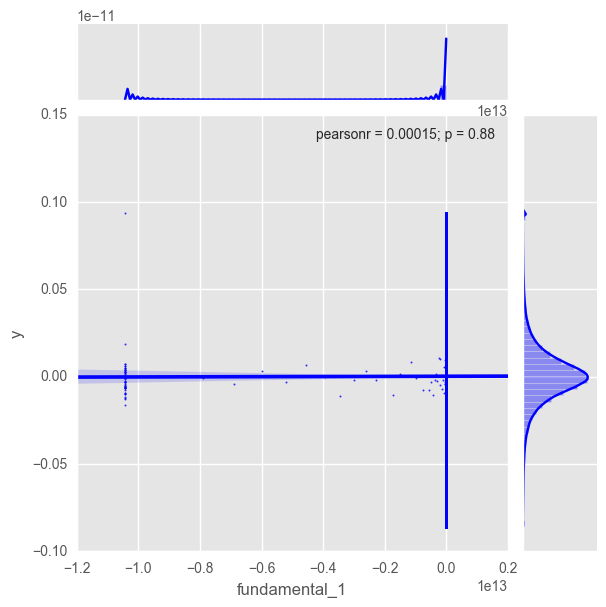

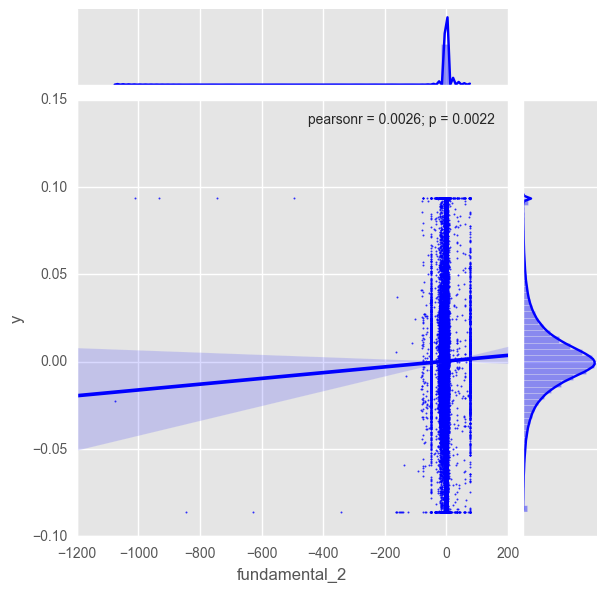

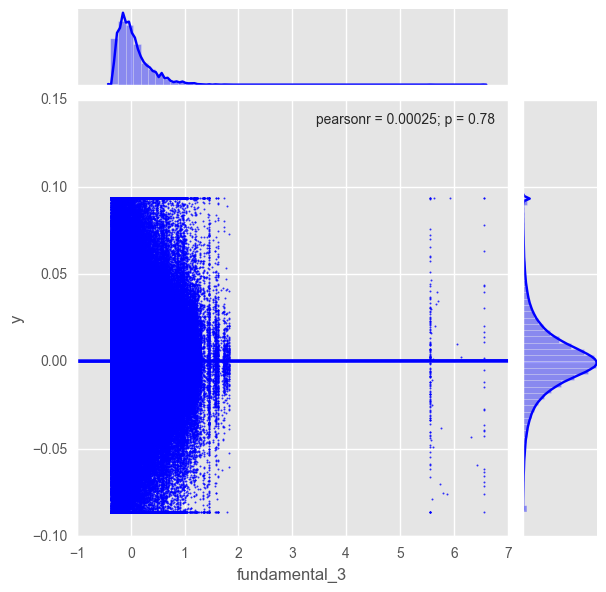

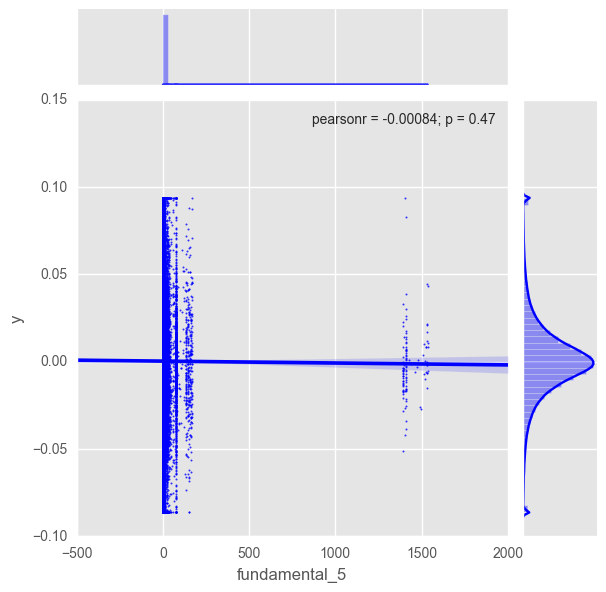

...

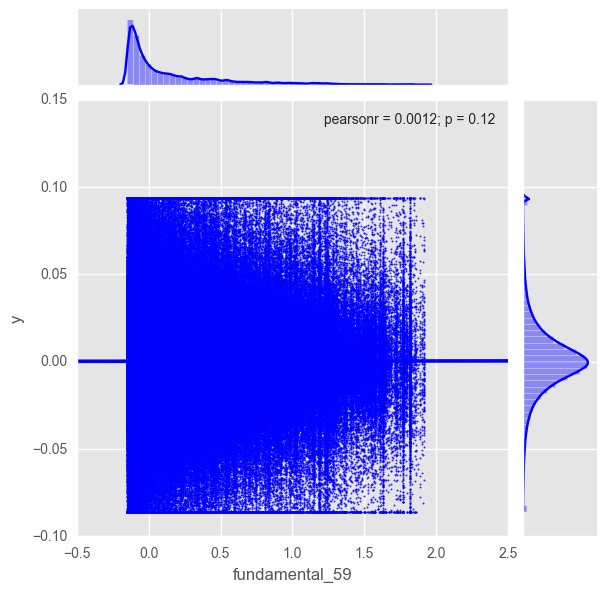

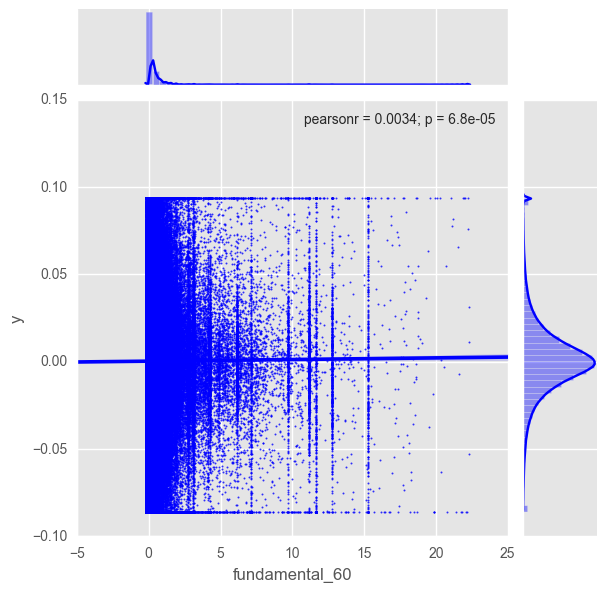

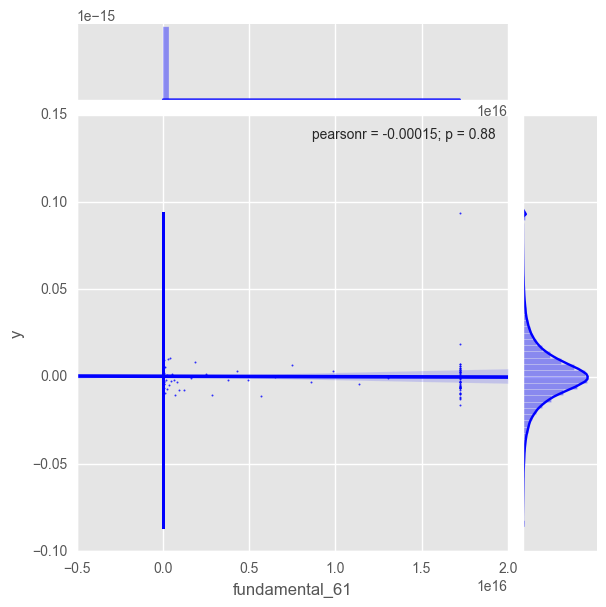

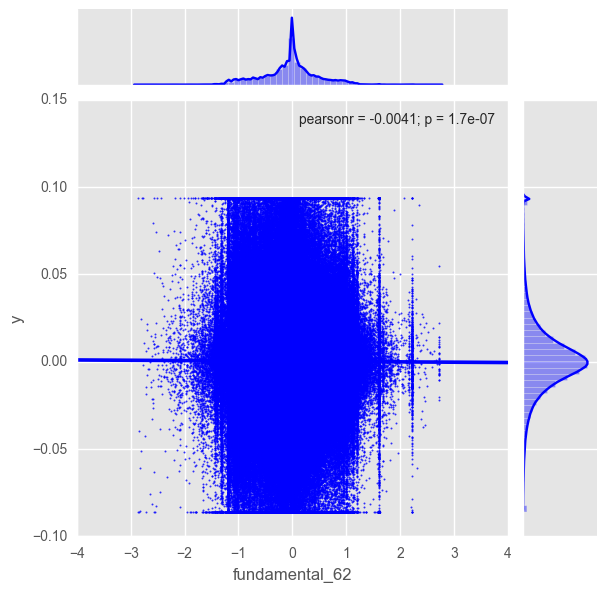

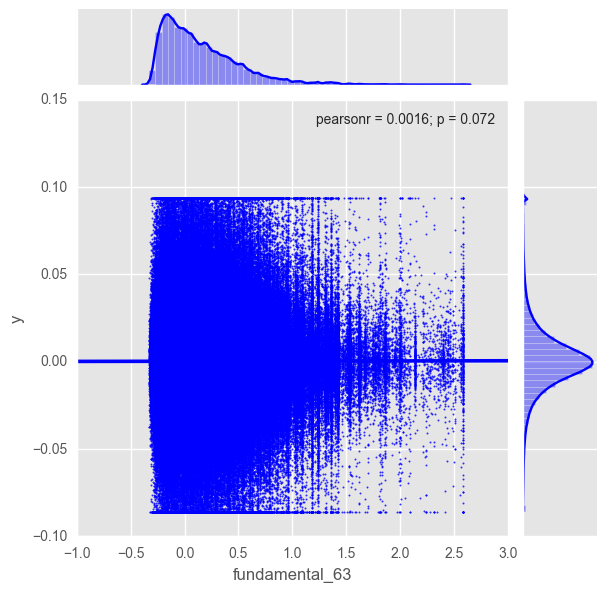

In [61]:
# plt.figure()
for c in fundamental_cols:
    plotc(train[[c,'y']])

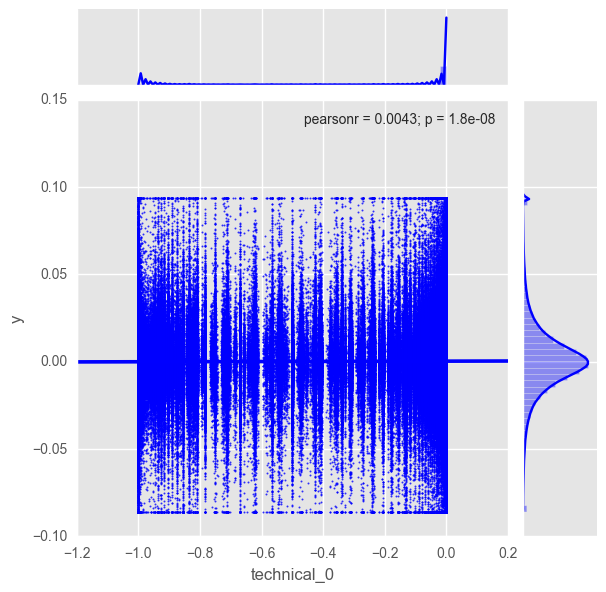

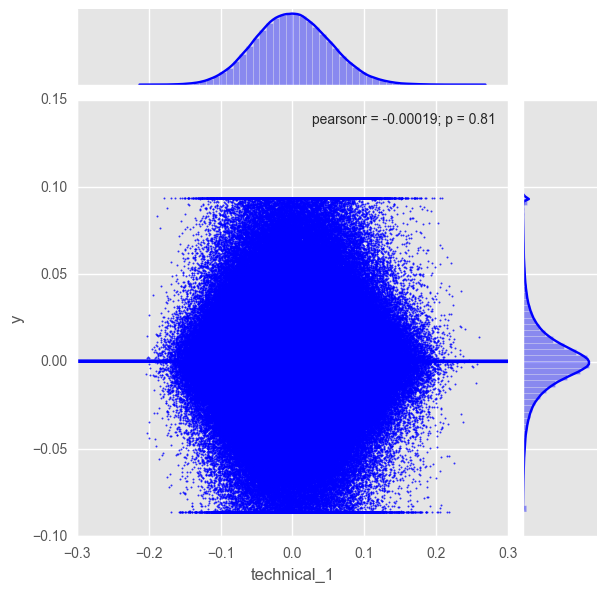

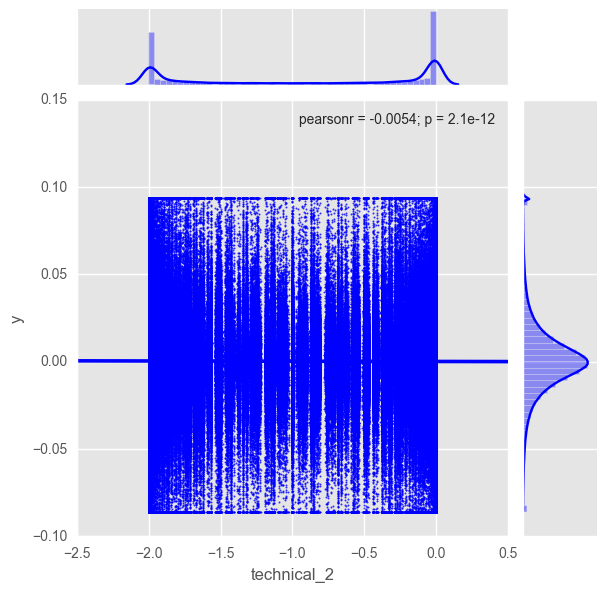

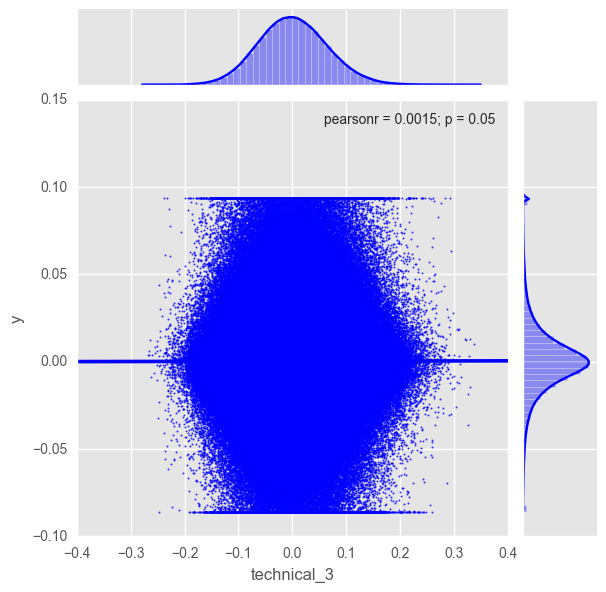

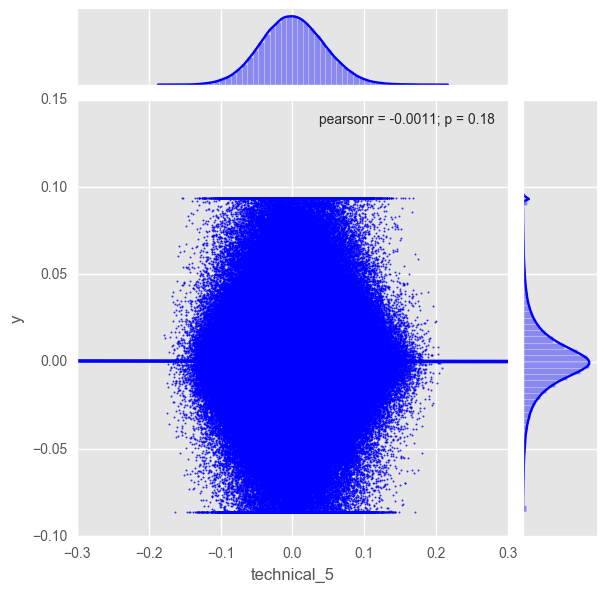

...

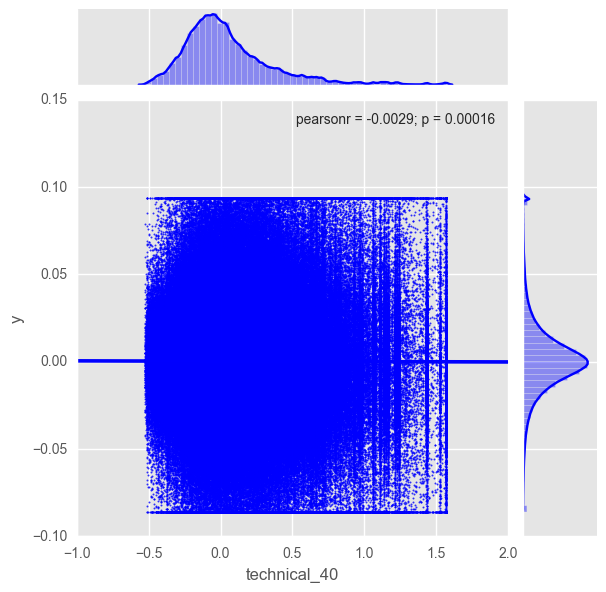

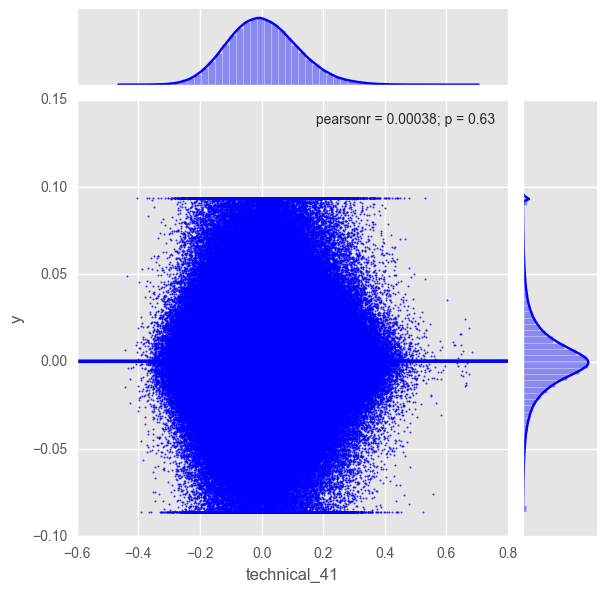

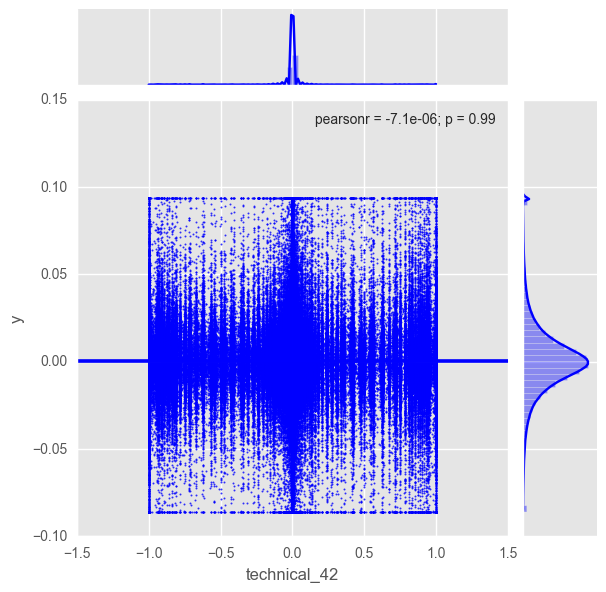

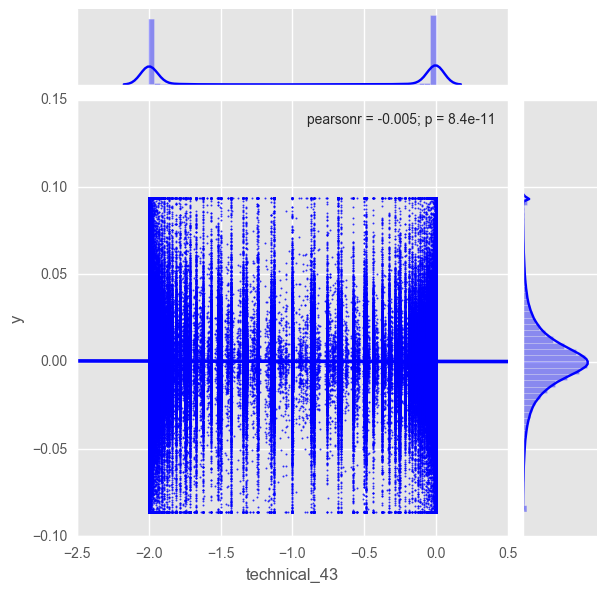

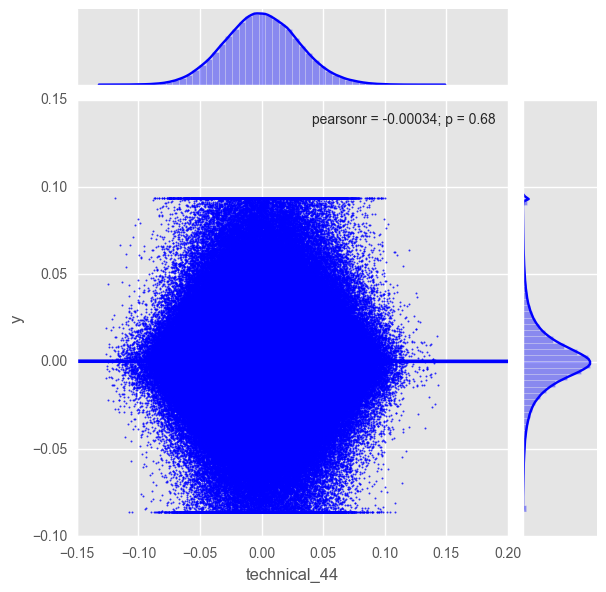

In [62]:
for c in technical_cols:
    plotc(train[[c,'y']])

## Technical Features
After looking at the technical features, I think they can be grouped based on what they look like:
- saw: sharp changes
- square: square waves
- moving: look like moving averages
- spike: look like daily % changes, much like target y

In [63]:
technical_saw = [1,3,5,24,25,28,31,33,41,44]
technical_square = [0,2,6,9,10,11,12,14,16,17,18,22,29,32,34,37,38,39,42,43]
technical_moving = [7,19,21,27,35,36,40]
technical_spike = [13,20,30]

In [64]:
technical_saw = ['technical_'+str(x) for x in technical_saw]
technical_square = ['technical_'+str(x) for x in technical_square]
technical_moving = ['technical_'+str(x) for x in technical_moving]
technical_spike = ['technical_'+str(x) for x in technical_spike]

In [65]:
print('saw:',technical_saw)
print('square:',technical_square)
print('moving:',technical_moving)
print('spike:',technical_spike)

saw: ['technical_1', 'technical_3', 'technical_5', 'technical_24', 'technical_25', 'technical_28', 'technical_31', 'technical_33', 'technical_41', 'technical_44']
square: ['technical_0', 'technical_2', 'technical_6', 'technical_9', 'technical_10', 'technical_11', 'technical_12', 'technical_14', 'technical_16', 'technical_17', 'technical_18', 'technical_22', 'technical_29', 'technical_32', 'technical_34', 'technical_37', 'technical_38', 'technical_39', 'technical_42', 'technical_43']
moving: ['technical_7', 'technical_19', 'technical_21', 'technical_27', 'technical_35', 'technical_36', 'technical_40']
spike: ['technical_13', 'technical_20', 'technical_30']


In [67]:
# Shape the train set into a panel
p_train = df_train.to_panel()
p_train = p_train.transpose(1,2,0)
p_train

<class 'pandas.core.panel.Panel'>
Dimensions: 1424 (items) x 1813 (major_axis) x 109 (minor_axis)
Items axis: 0 to 2158
Major_axis axis: 0 to 1812
Minor_axis axis: derived_0 to y

Let's see what they look like

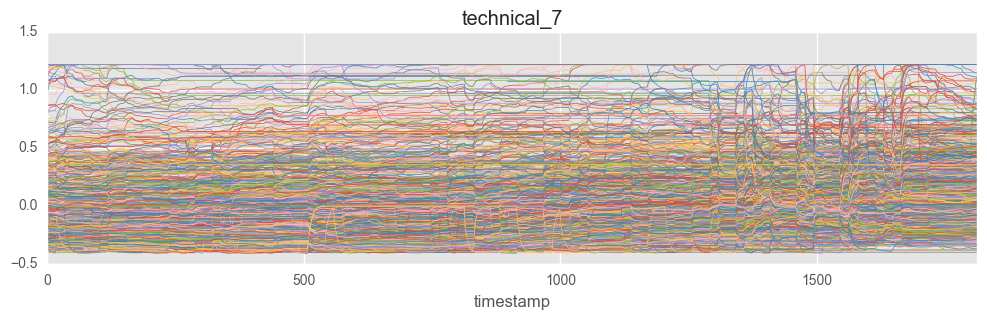

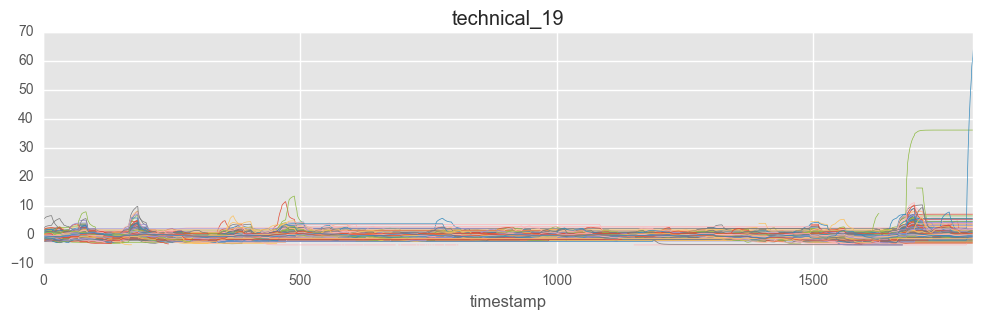

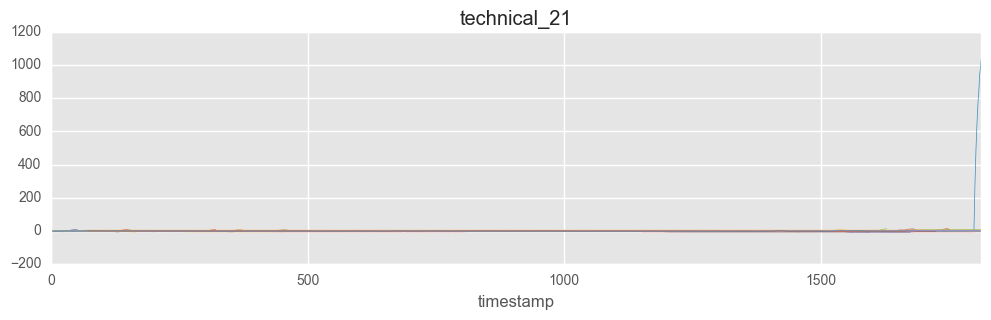

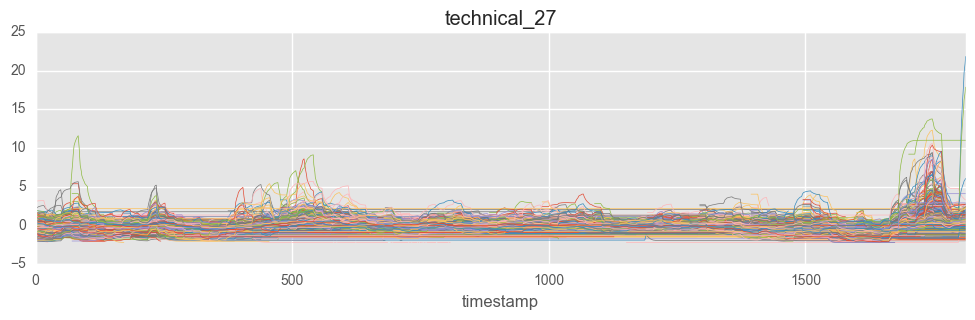

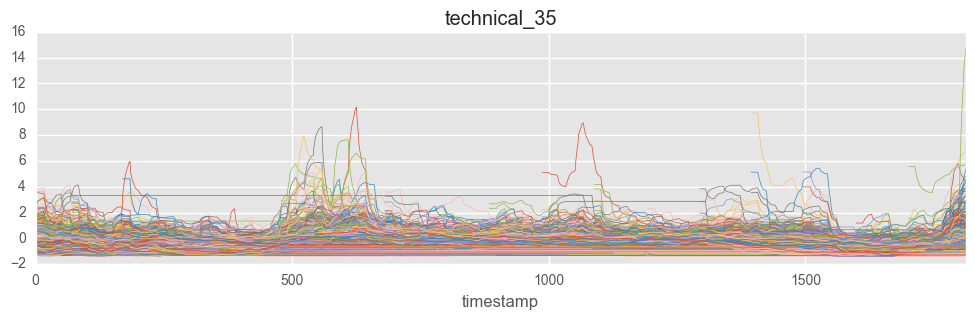

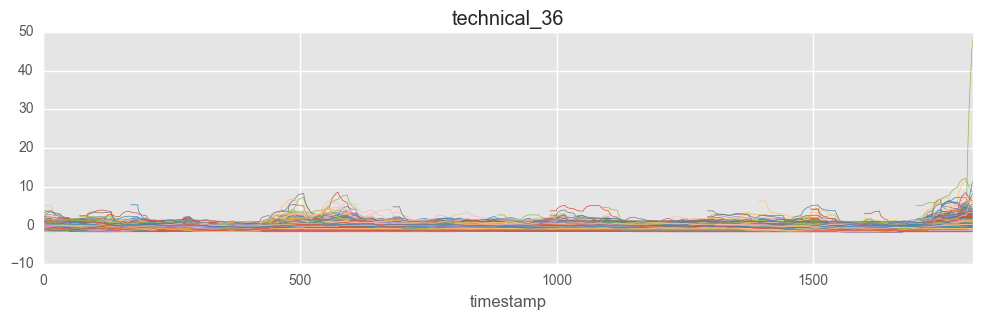

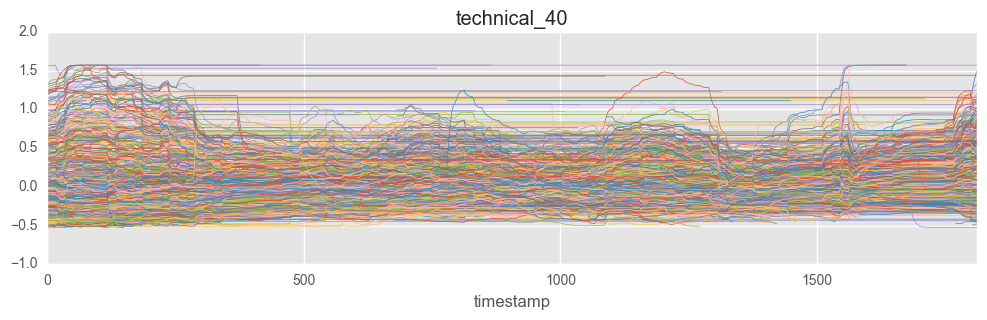

In [68]:
for t in technical_moving:
    for id, stock in p_train.iteritems():
        ax = stock[t].plot(figsize=(12,3), lw=0.5, title=t)
    plt.show()

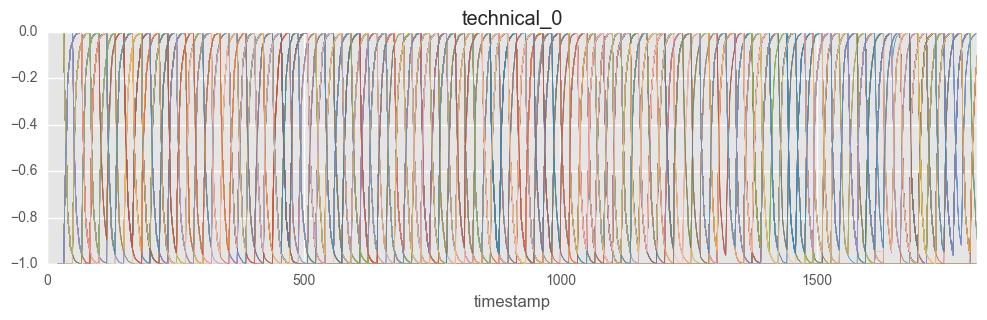

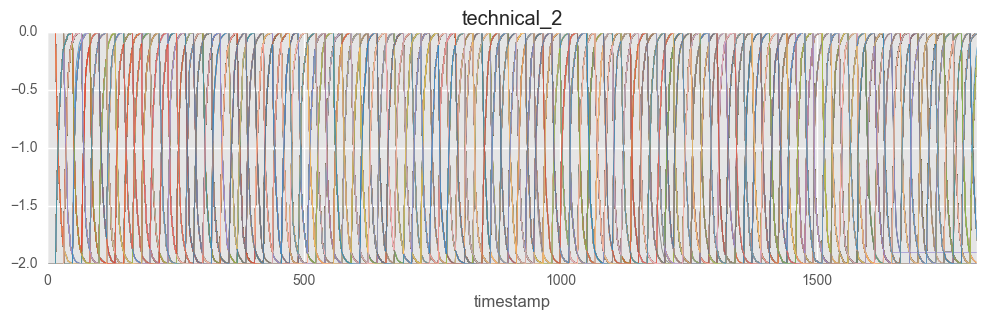

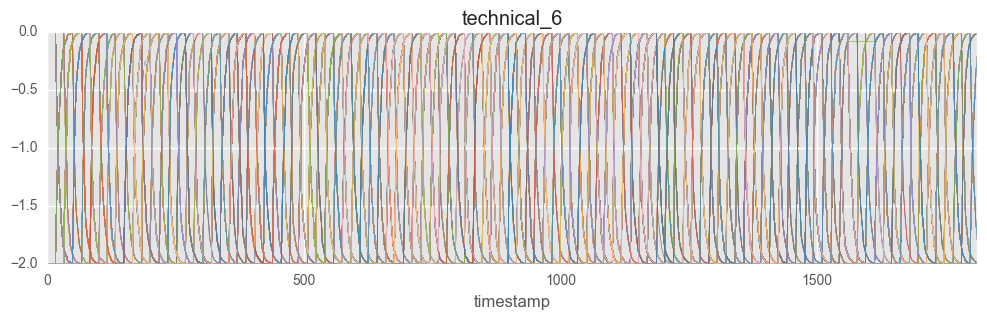

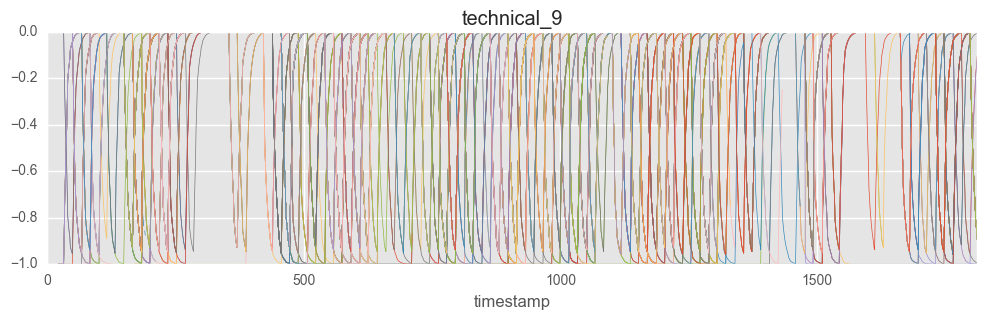

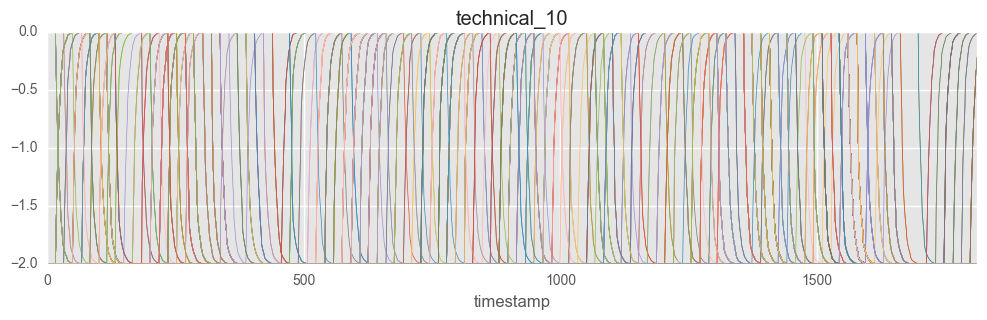

...

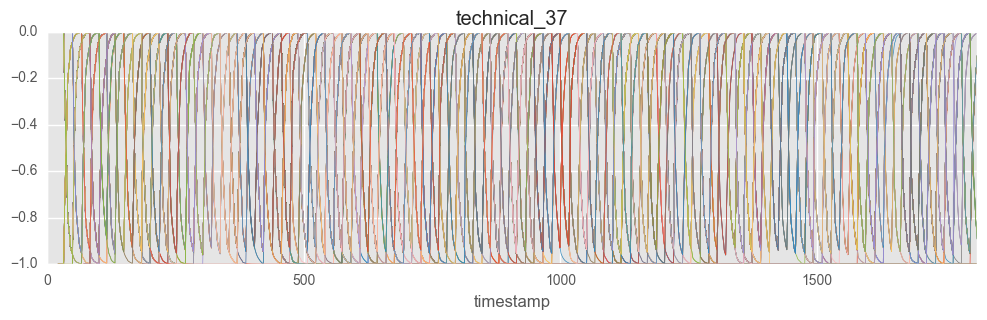

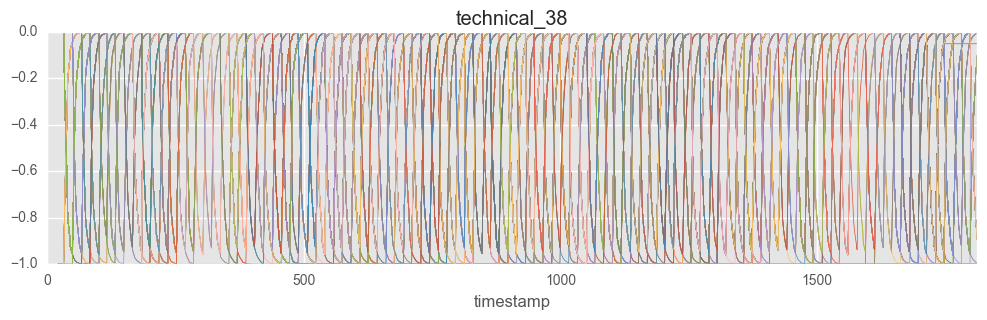

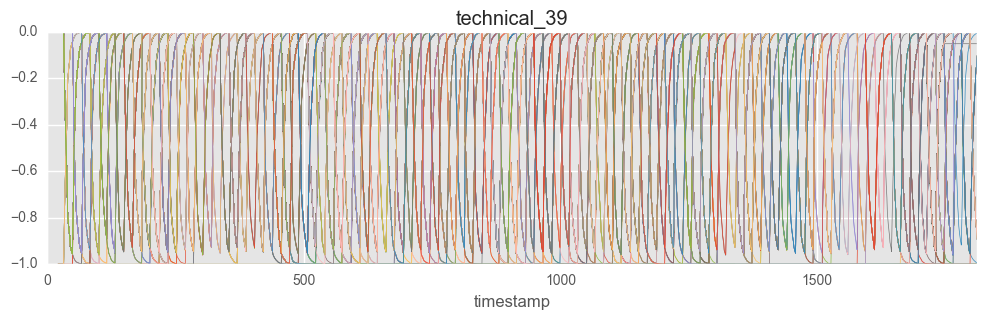

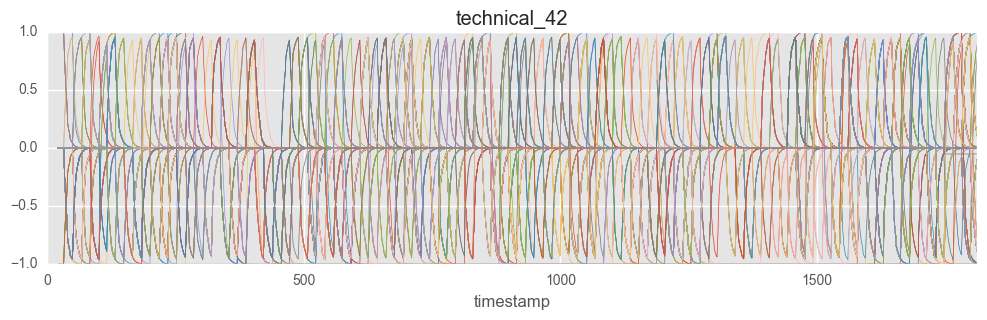

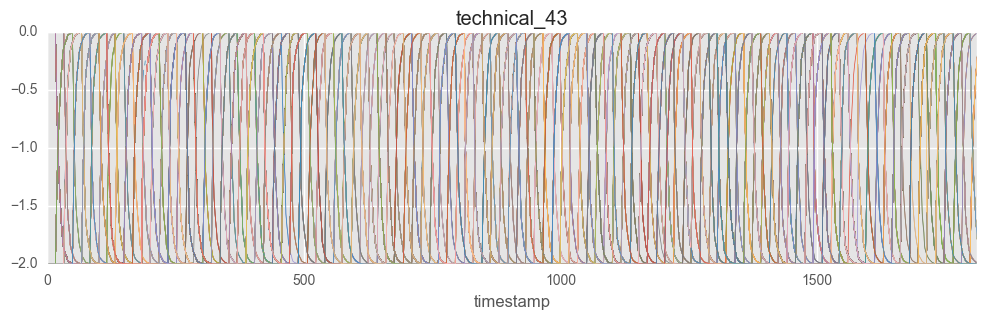

In [69]:
for t in technical_square:
    for id, stock in p_train.iteritems():
        ax = stock[t].plot(figsize=(12,3), lw=0.5, title=t)
    plt.show()

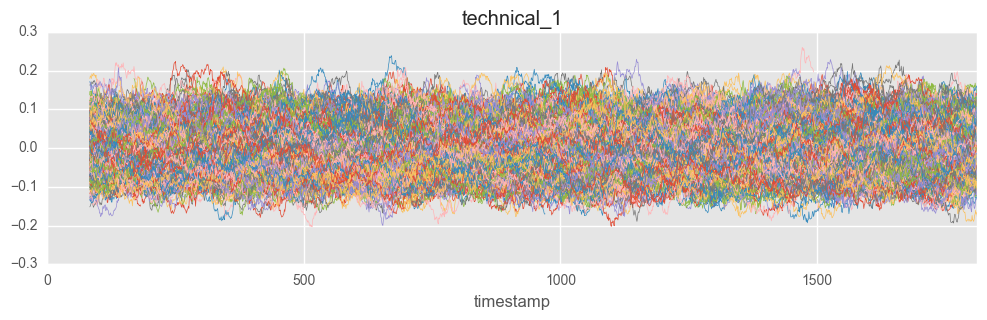

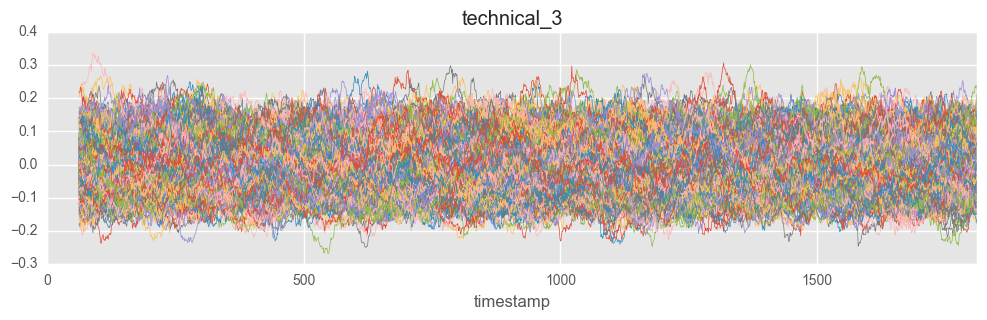

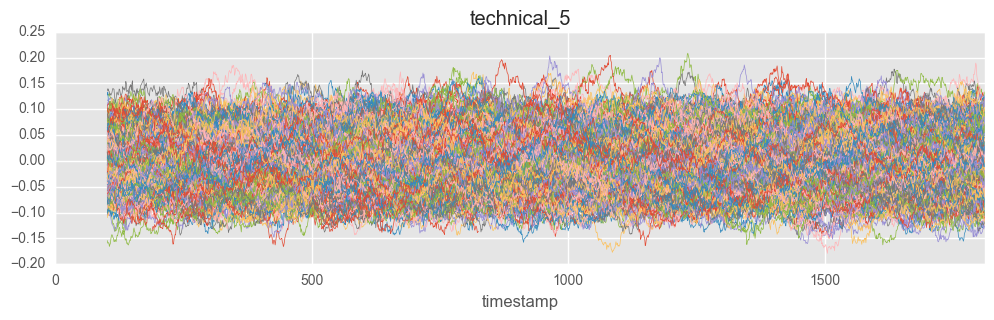

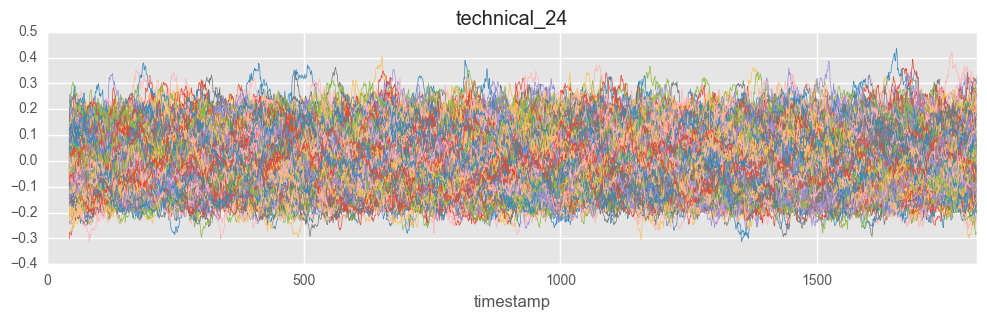

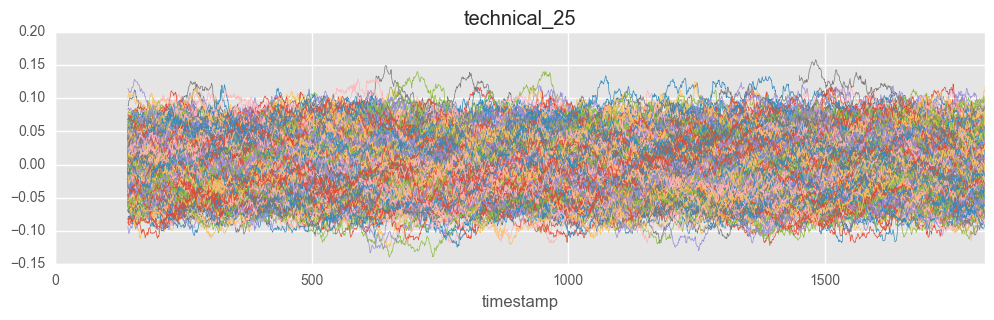

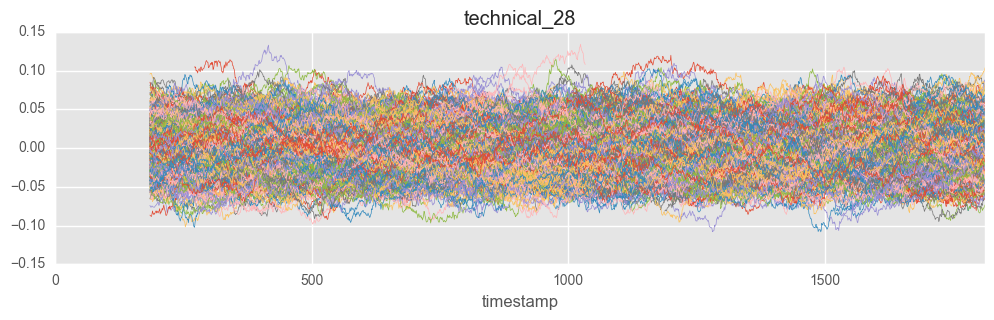

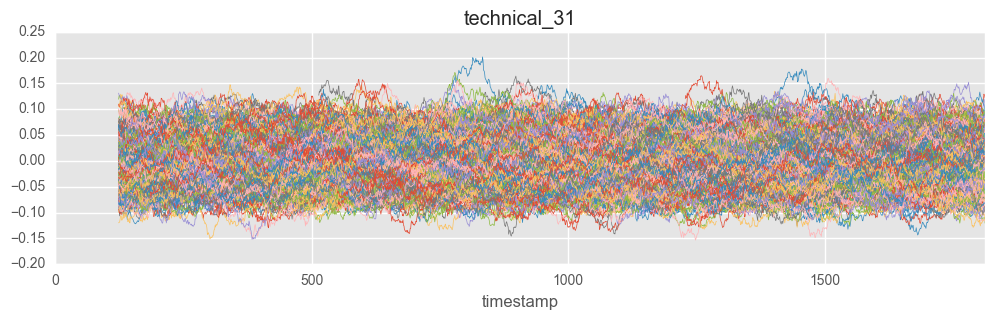

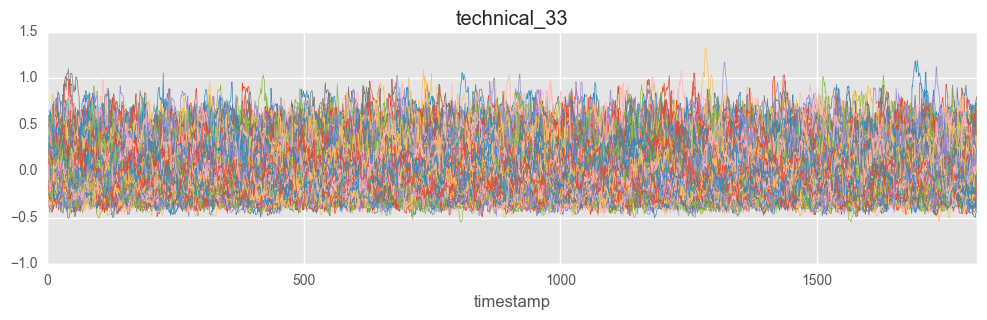

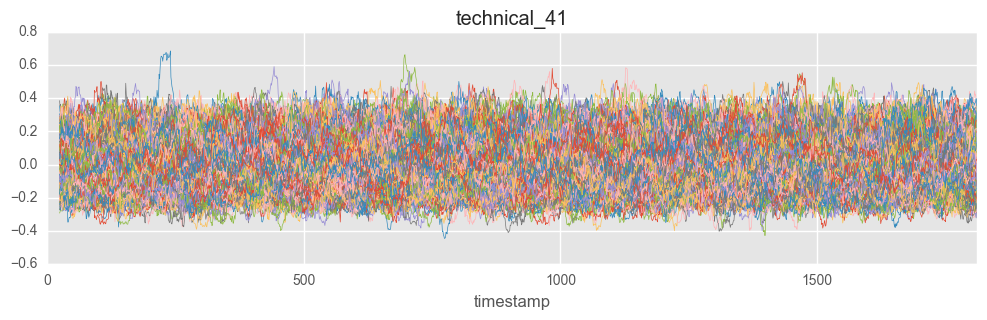

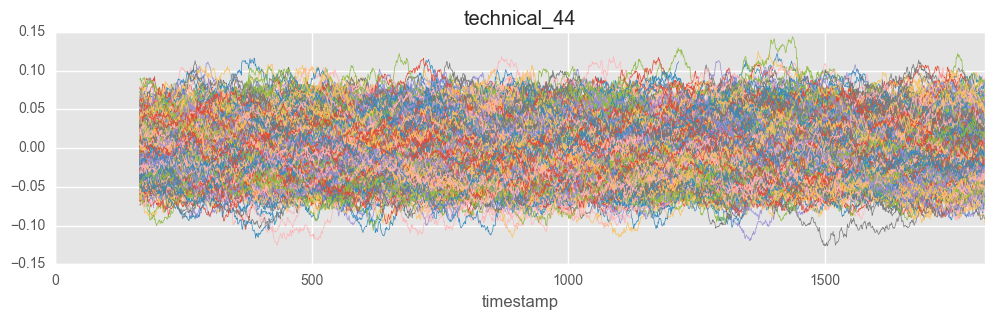

In [73]:
for t in technical_saw:
    for id, stock in p_train.iteritems():
        ax = stock[t].plot(figsize=(12,3), lw=0.5, title=t)
    plt.show()

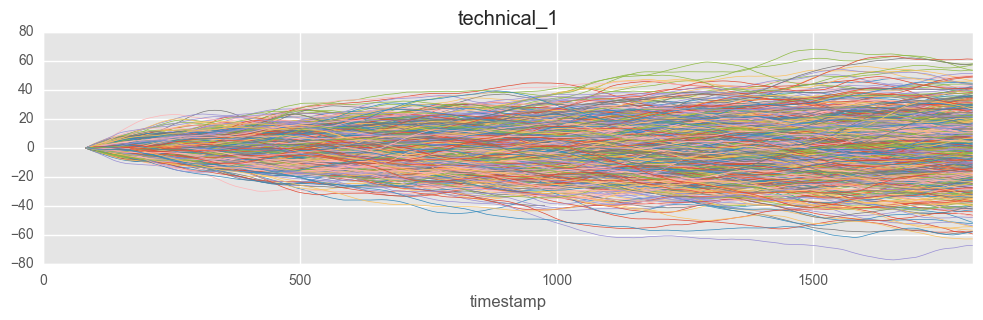

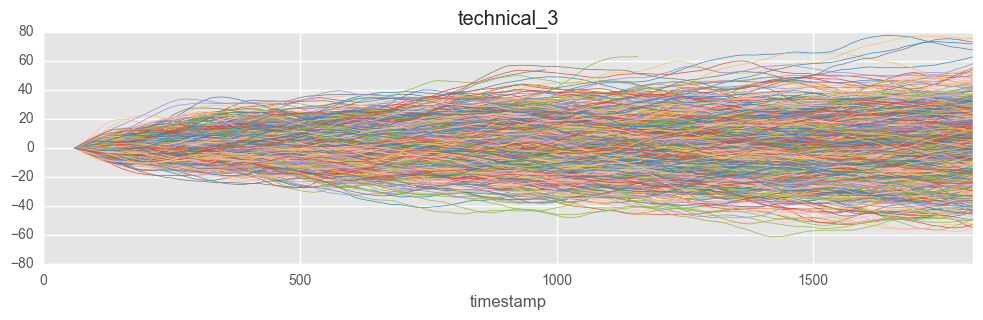

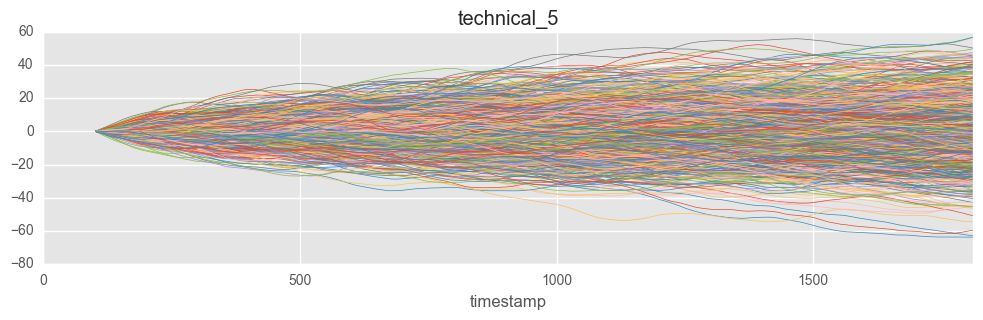

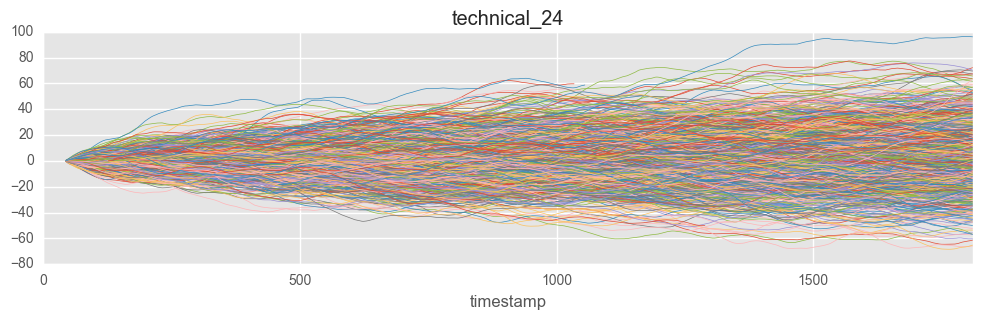

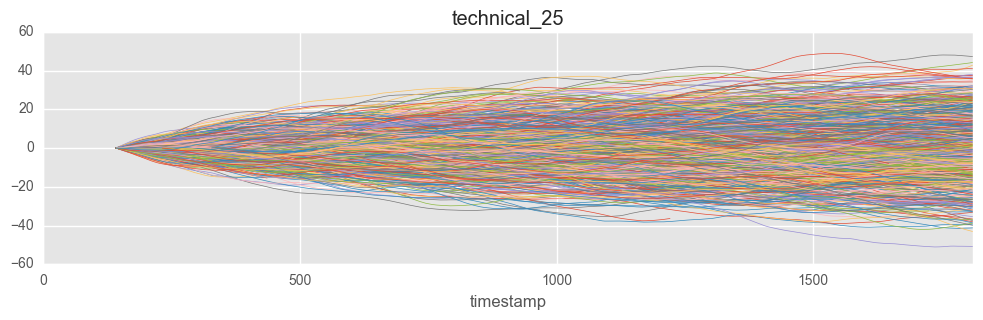

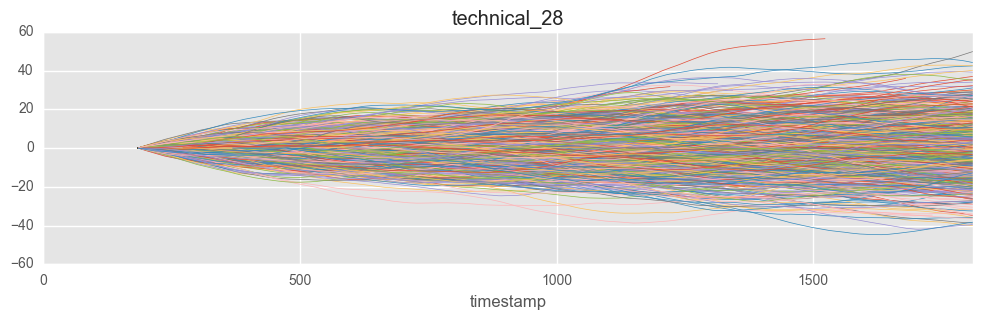

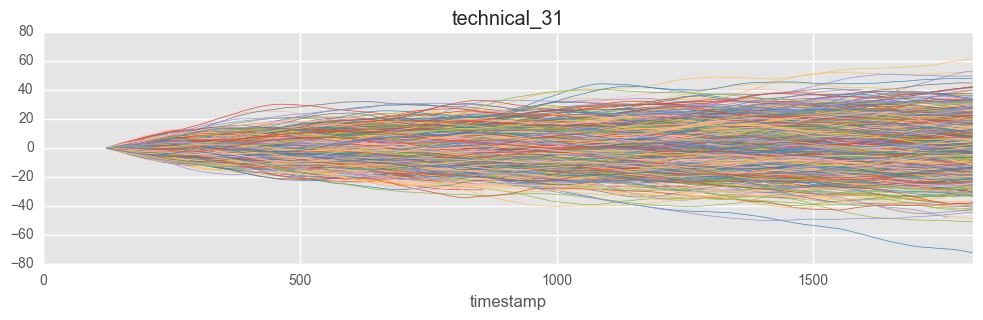

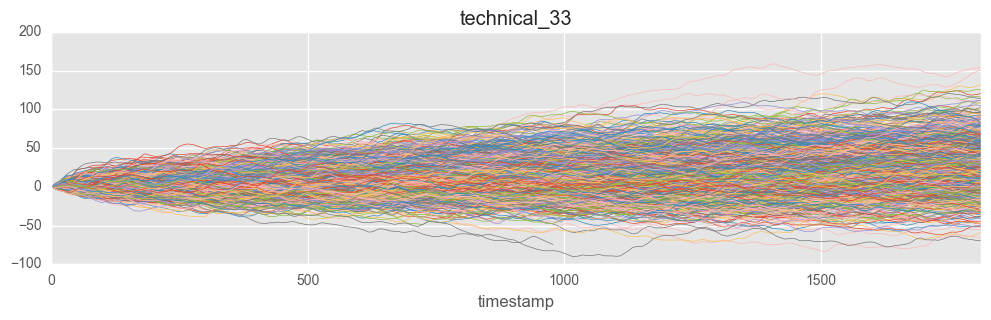

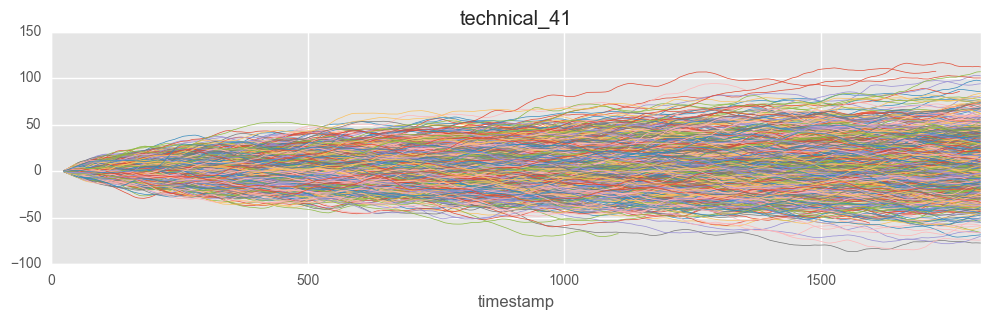

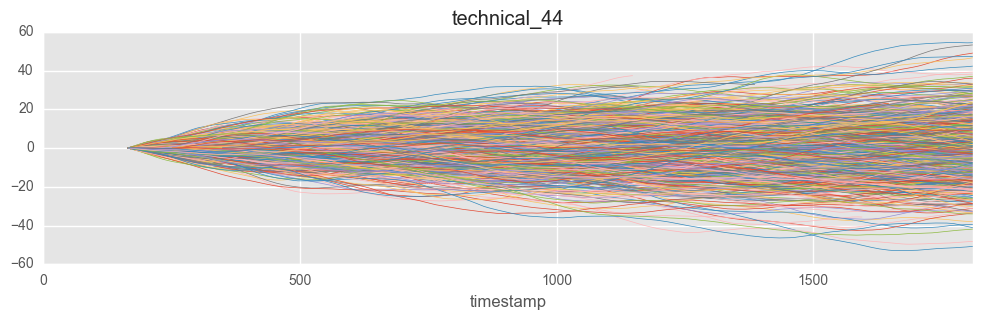

In [74]:
for t in technical_saw:
    for id, stock in p_train.iteritems():
        ax = stock[t].cumsum().plot(figsize=(12,3), lw=0.5, title=t)
    plt.show()

these look like running averages with delayed starts to accont for the number of days needed for the average.

## Q-Q Plots ?
- http://statsmodels.sourceforge.net/devel/generated/statsmodels.graphics.gofplots.qqplot.html

In [75]:
# Didn't have time

# EDA done by others:
- Good EDA: https://www.kaggle.com/poulet/two-sigma-financial-modeling/closeup-to-timestamps-features-and-assets/
- https://www.kaggle.com/sankhamukherjee/two-sigma-financial-modeling/simple-exploration-of-y-values/
- https://www.kaggle.com/ysidhu/two-sigma-financial-modeling/two-sigma-portfolio-returns-eda/notebook
- https://www.kaggle.com/heisengarg/two-sigma-financial-modeling/exploratory-data-analysis
- https://www.kaggle.com/tgogorza/two-sigma-financial-modeling/exploratory-data-analysis/
- time series: https://www.kaggle.com/jaychung/two-sigma-financial-modeling/exploring-time-series/
- time series: https://www.kaggle.com/txtrouble/two-sigma-financial-modeling/time-series-analysis-with-python/notebook
- https://www.kaggle.com/amhchiu/two-sigma-financial-modeling/investigating-timestamp-and-other-variables/notebook
- https://www.kaggle.com/sudalairajkumar/two-sigma-financial-modeling/simple-exploration-notebook/
- timestamp: https://www.kaggle.com/anokas/two-sigma-financial-modeling/two-sigma-time-travel-eda/
- NaN Structure: https://www.kaggle.com/chbimo/two-sigma-financial-modeling/correlation-of-nan-structure-between-id/
- NaN Continued: https://www.kaggle.com/cgump3rt/two-sigma-financial-modeling/missing-values-continued/
- NaN's: https://www.kaggle.com/reziproke/two-sigma-financial-modeling/nan-structure-on-id-level-eda
- R: https://www.kaggle.com/tentotheminus9/two-sigma-financial-modeling/r-eda/
- Clustering: https://www.kaggle.com/lesibius/two-sigma-financial-modeling/financial-instrument-types
- Clustering NaNs: https://www.kaggle.com/lesibius/two-sigma-financial-modeling/clustering-on-missing-values/
- Clustering y: https://www.kaggle.com/reziproke/two-sigma-financial-modeling/clustering-id-s-using-cumulative-return-eda
- Clustering: https://www.kaggle.com/allunia/two-sigma-financial-modeling/feature-dynamics-looking-at-id-groups
- Corr in time: https://www.kaggle.com/raddar/two-sigma-financial-modeling/variables-shifting-distributions-- 
- Corr in time: https://www.kaggle.com/stonematz/two-sigma-financial-modeling/peeking-into-the-technical-indicators
- correlations: https://www.kaggle.com/prabaltiwaree/two-sigma-financial-modeling/two-sigma-financial-modeling-data-analysis
- corr by id: https://www.kaggle.com/antklen/two-sigma-financial-modeling/correlations-with-target-for-different-id-s/
- PearsonR : https://www.kaggle.com/vigilanf/two-sigma-financial-modeling/heat-maps/run/511312/
- Q-Q plots: https://www.kaggle.com/tobikaggle/two-sigma-financial-modeling/probability-plots-for-all-variables/
- clusters tSNE: https://www.kaggle.com/jriskas/two-sigma-financial-modeling/asset-cluster-visualization
- clusters https://www.kaggle.com/rasuter/two-sigma-financial-modeling/a-basic-approch-to-cluster-securities
- t-SNE: https://www.kaggle.com/tobikaggle/two-sigma-financial-modeling/t-distributed-stochastic-neighbor-embedding/
- RF feature importance : https://www.kaggle.com/teramonagi/two-sigma-financial-modeling/feature-importances-by-randomforest/in-time/
- panel? : https://www.kaggle.com/mchlkffl/two-sigma-financial-modeling/data-exploration-panel-data-perspective
- SMA: https://www.kaggle.com/xchiron/two-sigma-financial-modeling/using-moving-average-on-individual-id-timestamps
- Trader: https://www.kaggle.com/miguelpm/two-sigma-financial-modeling/a-traders-eda
- when? : https://www.kaggle.com/sankhamukherjee/two-sigma-financial-modeling/when-why-are-stocks-bought-and-sold


In [76]:
# how long did this take to run top to bottom?
end = datetime.datetime.now()
print(end-start,end)

16:18:11.453664 2017-03-15 13:21:23.431078
